Measurement exploratory data analysis

In [27]:
from tabulate import tabulate
from IPython.display import Markdown, HTML
import matplotlib.pylab as plt
from typing import List, Tuple

import pandas as pd
import numpy as np
from scipy.signal import find_peaks
from scipy.signal import butter, lfilter

from tsfel.feature_extraction.features import fundamental_frequency

import os
import sys
sys.path.append('../../')
from feature import mafaulda as src
from feature import discovery as fdiscovery

pd.set_option("display.notebook_repr_html", False)

Define data sources

In [28]:
DIR = '../../air_conditioning/'
file_list = [
    DIR + 'excool_digitalis/high_pressure_pump_40percent__1.tsv',
    DIR + 'excool_digitalis/high_pressure_pump_40percent__2.tsv',
    DIR + 'excool_digitalis/high_pressure_pump_40percent_speed_up__3.tsv',
    DIR + 'excool_digitalis/high_pressure_pump_80percent__4.tsv',
    DIR + 'shc2/compressor_shc2_klima4_bad.tsv',
    DIR + 'shc2/compressor_shc2_klima5_good.tsv',
    DIR + 'vertiv_digitalis/compressor_top_1.tsv',
    DIR + 'vertiv_digitalis/compressor_top_2.tsv',
    DIR + 'vertiv_digitalis/compressor_top_3.tsv',
    DIR + 'vertiv_digitalis/compressor_base.tsv',
    DIR + 'vertiv_digitalis/compressor_side.tsv'
]
Fs = 1160     # 1160 Hz +/-150 Hz (1020 - 1340 Hz)


file_list = [
    DIR + 'fan/speeds/1_still.tsv',
    DIR + 'fan/speeds/2_still.tsv',
    DIR + 'fan/speeds/3_still.tsv',
    DIR + 'fan/speeds/1_up.tsv',
    DIR + 'fan/speeds/2_up.tsv',
    DIR + 'fan/speeds/3_up.tsv',
    DIR + 'fan/speeds/1_down.tsv',
    DIR + 'fan/speeds/2_down.tsv',
    DIR + 'fan/speeds/3_down.tsv',
]
Fs = 2500

T_WAVEFORM = 5
T_SEC = T_WAVEFORM
NFFT = 1024

DATASET = []

Import dataset

In [29]:
for filename in file_list:
    ts = pd.read_csv(filename, delimiter='\t', index_col=False, header=None, names=['x', 'y', 'z'])
    # Calculate amplitude in m/s^2 Beaglebone Black ADC and ADXL335 resolution (VIN 1.8V, 12bits)
    for dim in ts.columns:
        ts[dim] = ts[dim] * (1800 / 4096)  # ADC to mV
        ts[dim] = (ts[dim] / 180) * 9.81  # mV to m/s^2 (180 mV/g)
        ts[dim] -= ts[dim].mean()

    ts['t'] = ts.index * (1 / Fs)
    ts.set_index('t', inplace=True)
    DATASET.append((os.path.basename(filename), ts))

In [30]:
for name, ts in DATASET:
    display(Markdown(f'**{name}**'))
    ts.info()
    print()

**1_still.tsv**

<class 'pandas.core.frame.DataFrame'>
Index: 38201 entries, 0.0 to 15.280000000000001
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       38201 non-null  float64
 1   y       38200 non-null  float64
 2   z       38200 non-null  float64
dtypes: float64(3)
memory usage: 1.2 MB



**2_still.tsv**

<class 'pandas.core.frame.DataFrame'>
Index: 38201 entries, 0.0 to 15.280000000000001
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       38201 non-null  float64
 1   y       38200 non-null  float64
 2   z       38200 non-null  float64
dtypes: float64(3)
memory usage: 1.2 MB



**3_still.tsv**

<class 'pandas.core.frame.DataFrame'>
Index: 38201 entries, 0.0 to 15.280000000000001
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       38201 non-null  float64
 1   y       38200 non-null  float64
 2   z       38200 non-null  float64
dtypes: float64(3)
memory usage: 1.2 MB



**1_up.tsv**

<class 'pandas.core.frame.DataFrame'>
Index: 38201 entries, 0.0 to 15.280000000000001
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       38201 non-null  float64
 1   y       38200 non-null  float64
 2   z       38200 non-null  float64
dtypes: float64(3)
memory usage: 1.2 MB



**2_up.tsv**

<class 'pandas.core.frame.DataFrame'>
Index: 38201 entries, 0.0 to 15.280000000000001
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       38201 non-null  float64
 1   y       38200 non-null  float64
 2   z       38200 non-null  float64
dtypes: float64(3)
memory usage: 1.2 MB



**3_up.tsv**

<class 'pandas.core.frame.DataFrame'>
Index: 38201 entries, 0.0 to 15.280000000000001
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       38201 non-null  float64
 1   y       38200 non-null  float64
 2   z       38200 non-null  float64
dtypes: float64(3)
memory usage: 1.2 MB



**1_down.tsv**

<class 'pandas.core.frame.DataFrame'>
Index: 38201 entries, 0.0 to 15.280000000000001
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       38201 non-null  float64
 1   y       38200 non-null  float64
 2   z       38200 non-null  float64
dtypes: float64(3)
memory usage: 1.2 MB



**2_down.tsv**

<class 'pandas.core.frame.DataFrame'>
Index: 38201 entries, 0.0 to 15.280000000000001
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       38201 non-null  float64
 1   y       38200 non-null  float64
 2   z       38200 non-null  float64
dtypes: float64(3)
memory usage: 1.2 MB



**3_down.tsv**

<class 'pandas.core.frame.DataFrame'>
Index: 38201 entries, 0.0 to 15.280000000000001
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       38201 non-null  float64
 1   y       38200 non-null  float64
 2   z       38200 non-null  float64
dtypes: float64(3)
memory usage: 1.2 MB



In [31]:
for name, ts in DATASET:
    display(Markdown(f'**{name}**'))
    display(tabulate(ts.describe(), headers='keys', tablefmt='html'))

**1_still.tsv**

,x,y,z
count,38201,38200,38200
mean,-2.40499e-15,3.95579e-15,3.23185e-15
std,0.875637,1.2639,0.0920418
min,-9.07143,-2.52106,-0.348954
25%,-0.593063,-1.108,-0.061552
50%,0.0056921,-0.00628912,0.0102986
75%,0.580497,1.11937,0.058199
max,1.96961,2.43663,0.345601


**2_still.tsv**

,x,y,z
count,38201,38200,38200
mean,5.15893e-15,6.06082e-15,2.94447e-15
std,2.56549,2.48179,0.322518
min,-9.24575,-3.73282,-0.952338
25%,-2.44389,-2.63111,-0.281733
50%,0.430129,0.0752644,0.00566968
75%,2.27429,2.56608,0.269122
max,4.04661,3.66779,0.987628


**3_still.tsv**

,x,y,z
count,38201,38200,38200
mean,2.19072e-15,-3.27184e-16,1.05735e-14
std,2.15206,2.64354,0.396043
min,-9.32173,-4.12174,-0.786905
25%,-2.13667,-2.58893,-0.379752
50%,-0.244608,-0.0502045,0.00345146
75%,1.95881,2.56635,0.362704
max,3.92273,4.21293,0.841708


**1_up.tsv**

,x,y,z
count,38201,38200,38200
mean,7.1722e-16,1.16068e-15,-4.63229e-15
std,0.851834,1.19633,0.160765
min,-9.19537,-2.62078,-0.818255
25%,-0.381696,-0.704763,-0.0757992
50%,0.00150719,-0.010207,-0.00394865
75%,0.408661,0.756199,0.0679019
max,2.01332,2.57641,0.930109


**2_up.tsv**

,x,y,z
count,38201,38200,38200
mean,1.32693e-15,-5.37892e-15,3.77964e-16
std,2.54069,2.40738,0.506515
min,-9.66708,-4.29866,-1.69449
25%,-1.97907,-2.23894,-0.305381
50%,0.00879927,0.0123751,0.0778218
75%,1.99667,2.16789,0.341274
max,5.58919,4.61081,1.44298


**3_up.tsv**

,x,y,z
count,38201,38200,38200
mean,1.09015e-15,-3.60256e-15,1.23954e-15
std,1.69941,2.35114,0.38339
min,-9.81719,-4.07792,-0.81214
25%,-1.53042,-2.18586,-0.333137
50%,-0.0694594,0.0415091,0.00216618
75%,1.3436,2.10123,0.337469
max,3.93022,4.23279,1.12783


**1_down.tsv**

,x,y,z
count,38201,38200,38200
mean,6.07666e-15,-9.52239e-15,-2.13758e-15
std,0.276292,0.355092,0.0934928
min,-9.08741,-2.01469,-0.868043
25%,-0.0342404,-0.0268261,-0.0297866
50%,-0.0102902,-0.0028759,0.0181137
75%,0.01366,0.0210743,0.0420639
max,3.34274,2.05684,0.664769


**2_down.tsv**

,x,y,z
count,38201,38200,38200
mean,-3.53755e-15,4.22792e-16,2.48355e-15
std,0.911499,0.87873,0.242263
min,-9.16459,-3.82467,-1.76085
25%,-0.0156161,-0.0405354,-0.0124892
50%,0.00833407,0.007365,0.0354112
75%,0.0322843,0.0313152,0.0833116
max,4.89417,3.9352,1.56822


**3_down.tsv**

,x,y,z
count,38201,38200,38200
mean,3.38727e-15,-9.63697e-16,-5.49685e-15
std,0.676631,0.924902,0.236818
min,-9.08527,-3.8726,-3.24596
25%,-0.0321006,-0.0405711,-0.0126823
50%,0.0157998,0.00732926,0.0591683
75%,0.03975,0.0552297,0.0831185
max,3.77598,4.22256,7.81903


Time domain waveform

**1_still.tsv**

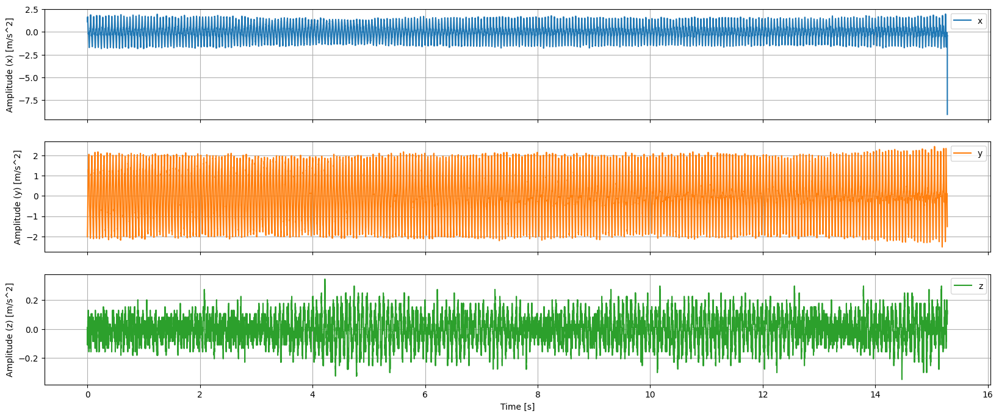

**2_still.tsv**

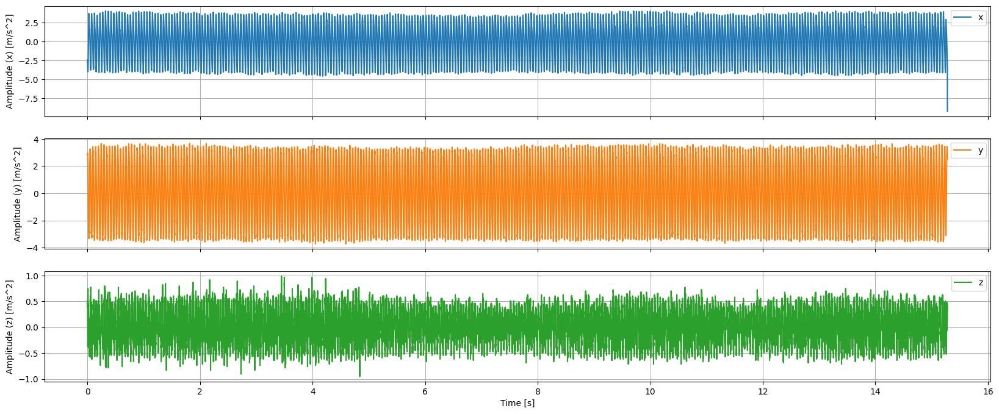

**3_still.tsv**

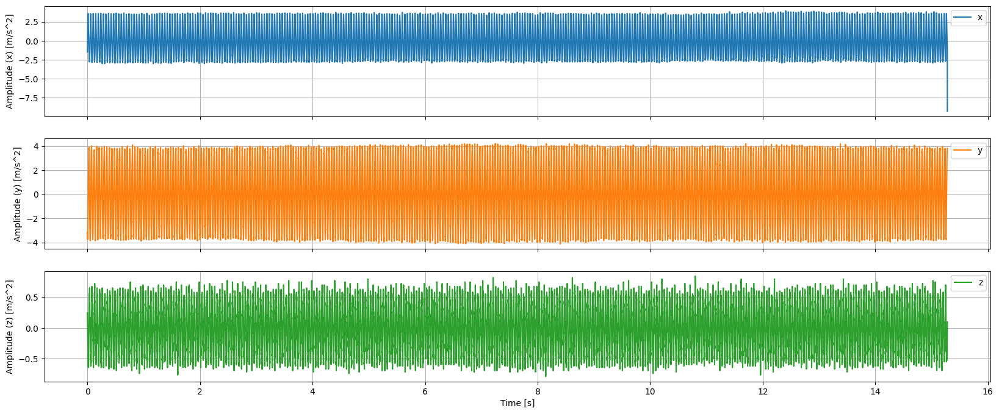

**1_up.tsv**

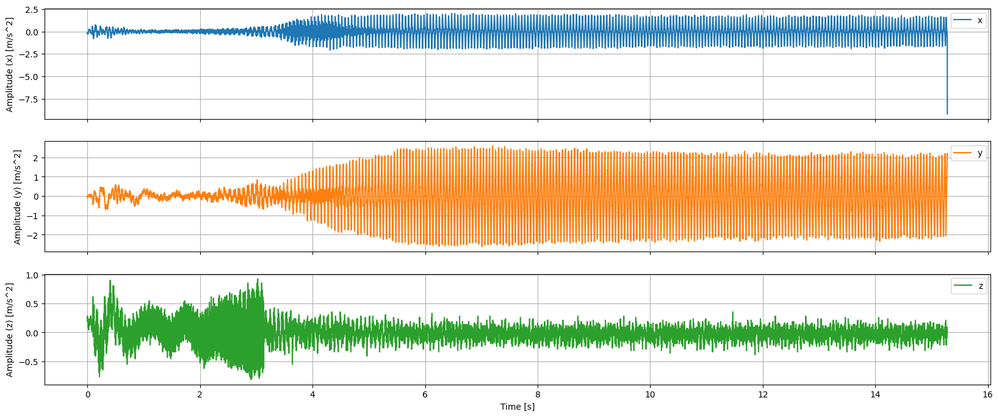

**2_up.tsv**

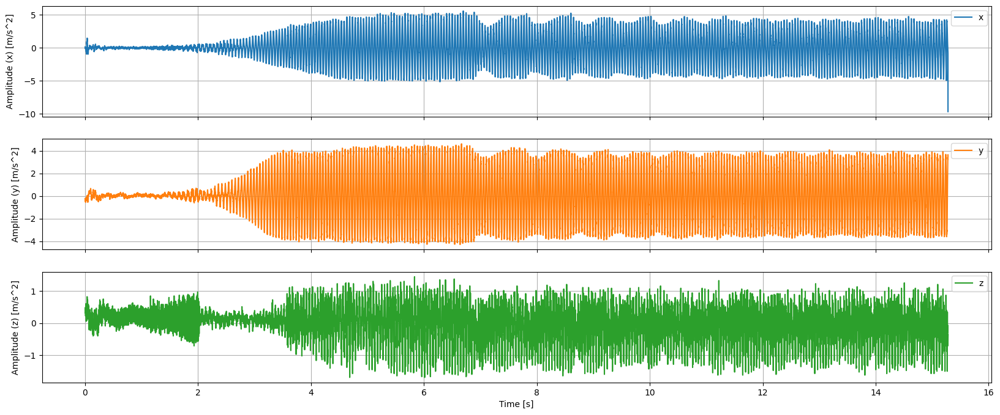

**3_up.tsv**

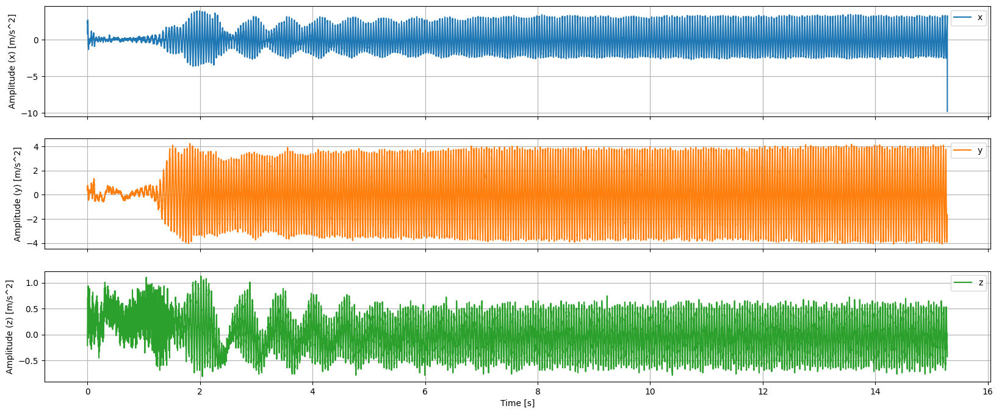

**1_down.tsv**

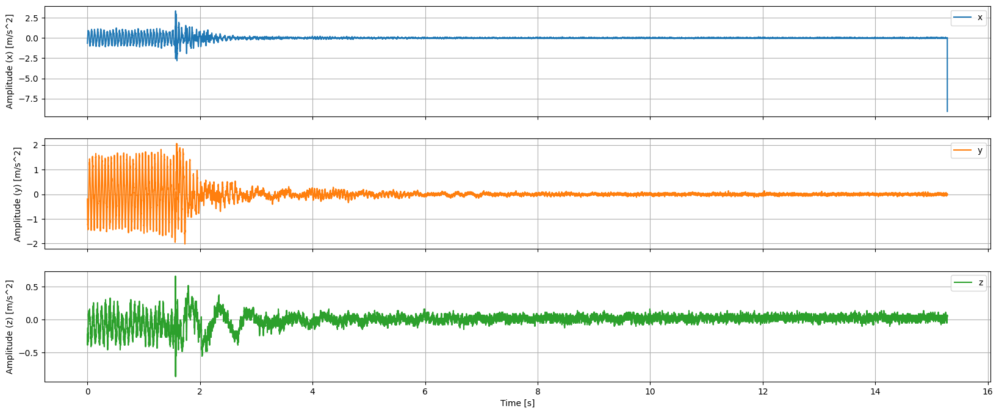

**2_down.tsv**

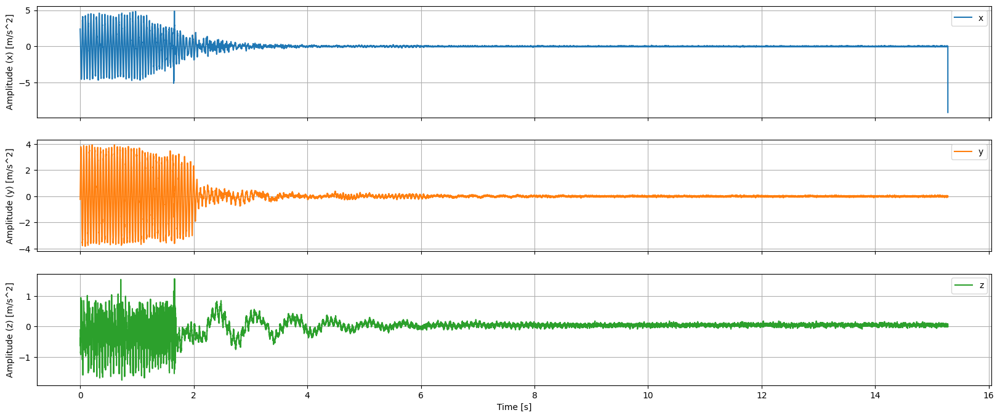

**3_down.tsv**

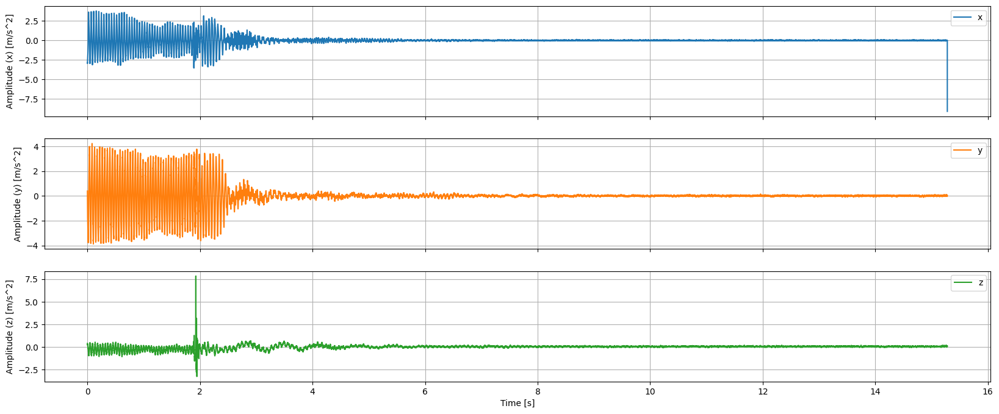

In [32]:
axis = ['x', 'y', 'z']
for name, ts in DATASET:
    display(Markdown(f'**{name}**'))
    
    ax = ts[axis].plot(figsize=(20, 8), grid=True, subplots=True)
    for i, axname in enumerate(axis):
        ax[i].set_xlabel('Time [s]')
        ax[i].set_ylabel(f'Amplitude ({axname}) [m/s^2]')
    plt.show()               # plt.savefig('waveform.png')

Time domain waveform zoom detail

**1_still.tsv**

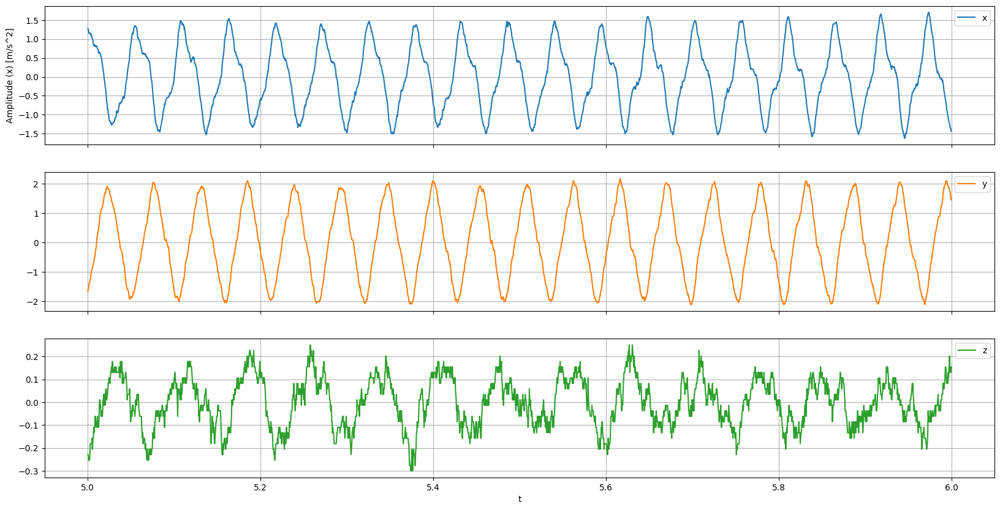

**2_still.tsv**

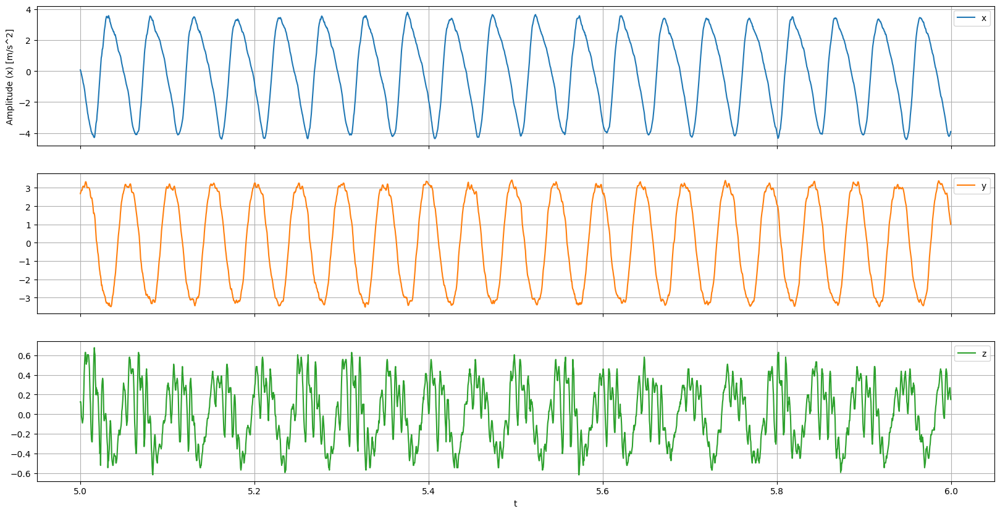

**3_still.tsv**

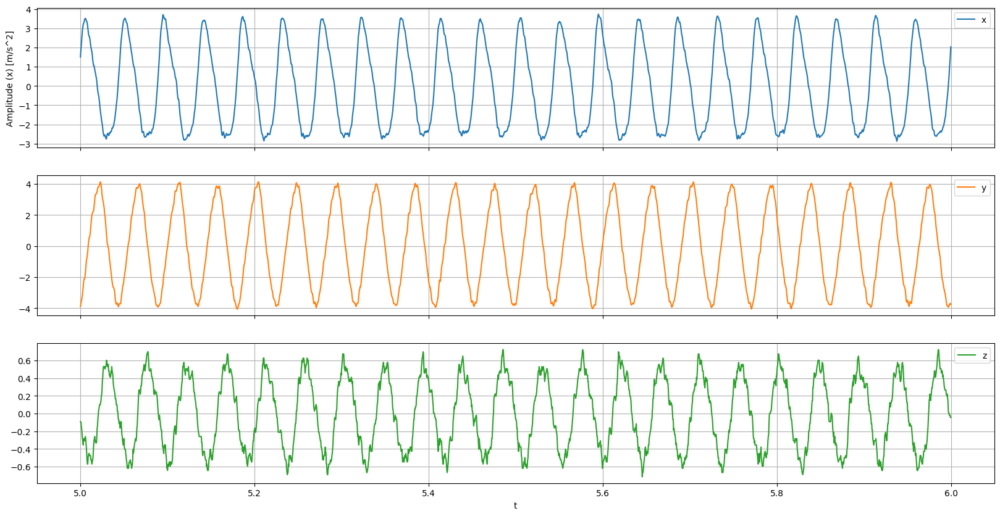

**1_up.tsv**

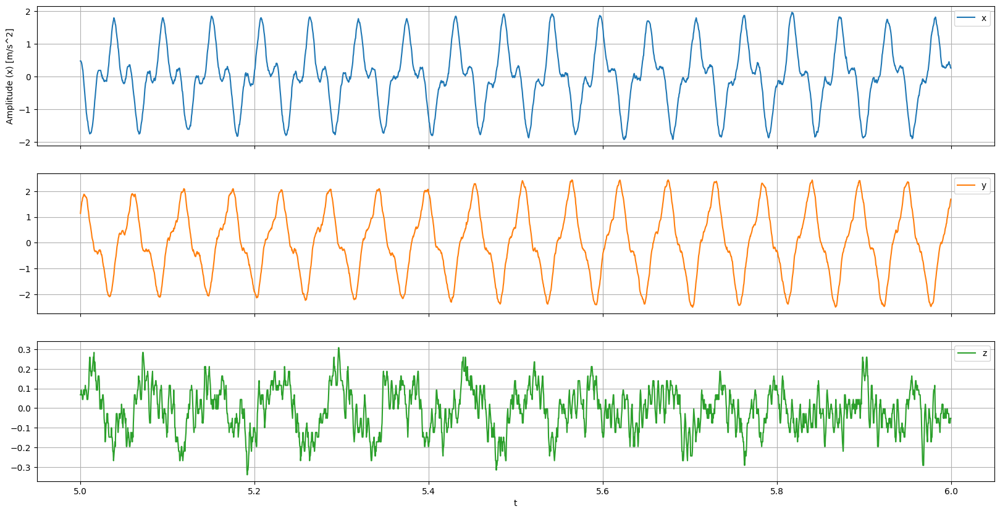

**2_up.tsv**

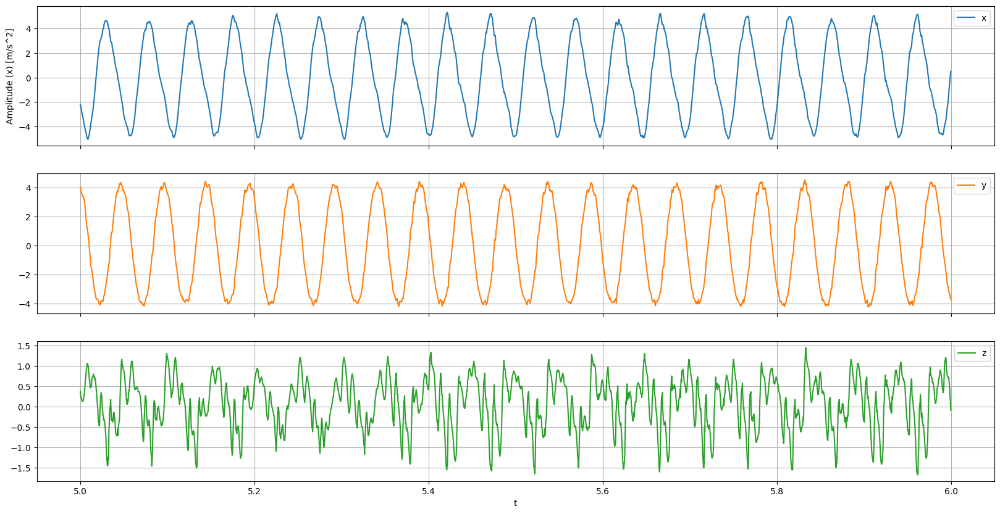

**3_up.tsv**

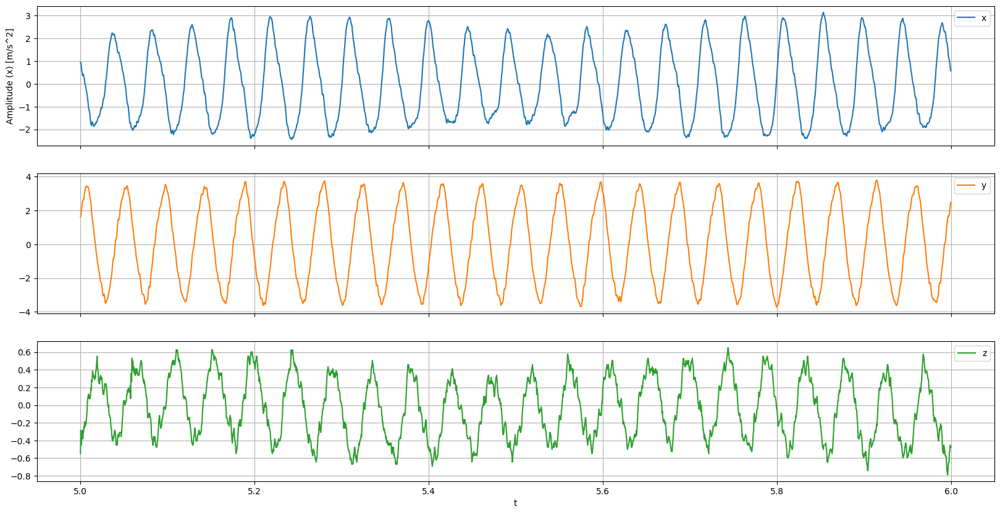

**1_down.tsv**

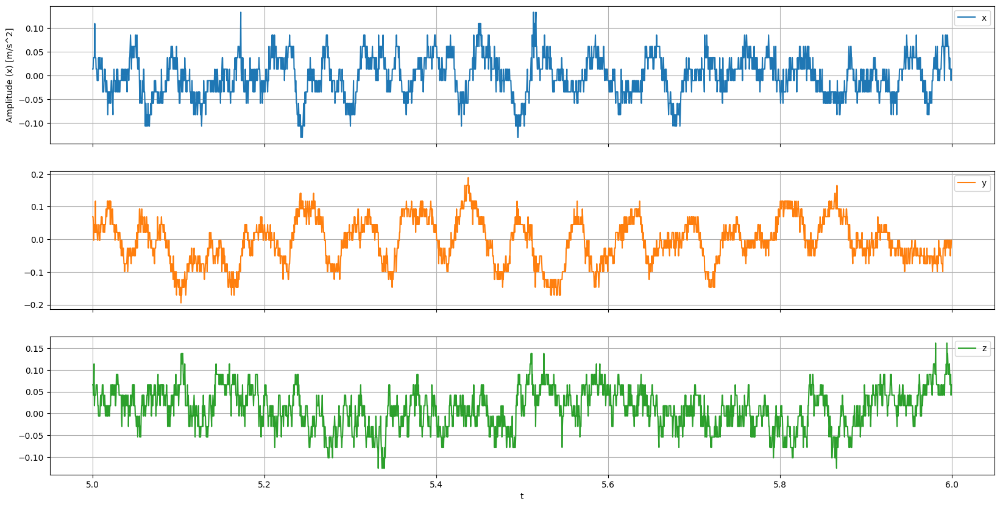

**2_down.tsv**

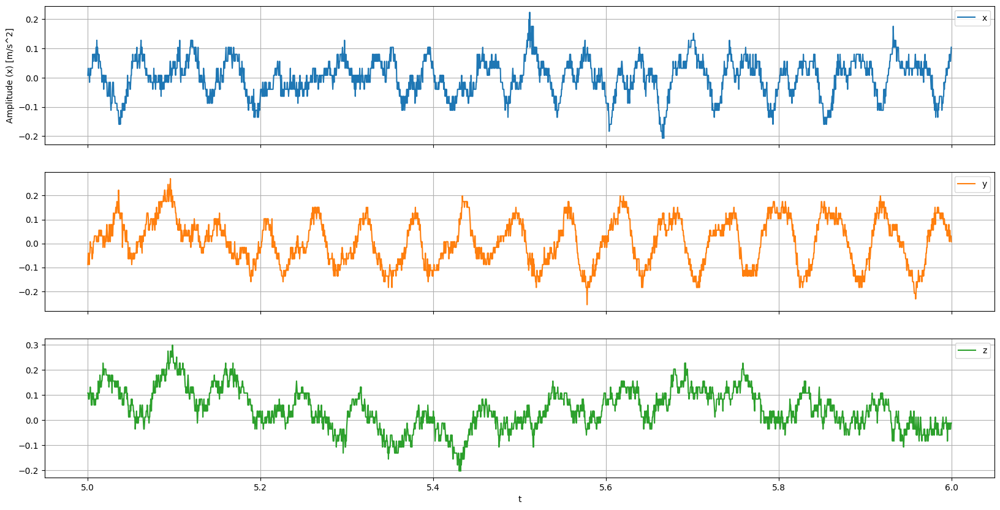

**3_down.tsv**

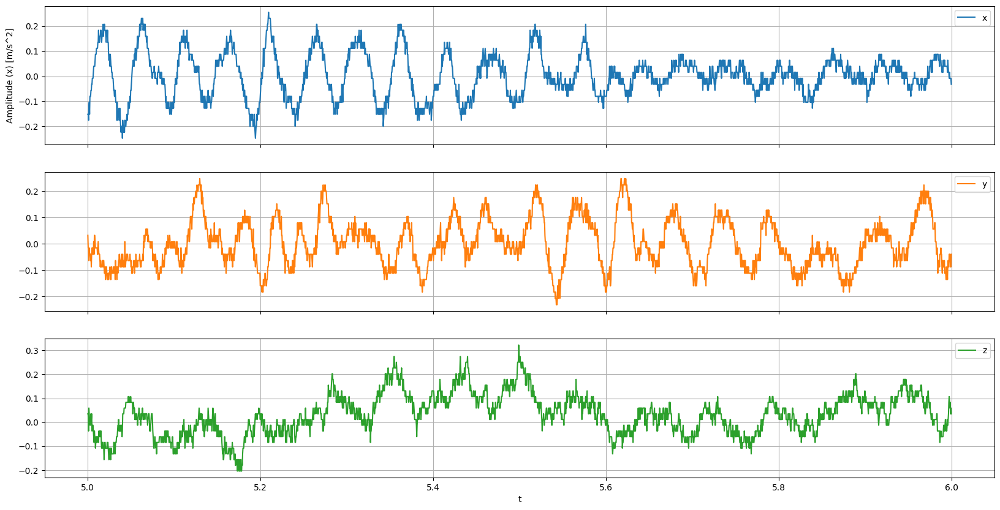

In [33]:
axis = ['x', 'y', 'z']
for name, ts in DATASET:
    display(Markdown(f'**{name}**'))
    ax = (ts[axis].iloc[int(T_WAVEFORM*Fs):int(T_WAVEFORM*Fs)+Fs]
                  .plot(figsize=(20, 10), grid=True, subplots=True))
    
    for i, axname in enumerate(axis):
        ax[i].set_xlabel('Time [s]')
        ax[i].set_ylabel(f'Amplitude ({axname}) [m/s^2]')
        plt.show()      # plt.savefig('waveform_zoom.png')

In [34]:
def spectogram(x):
    fig, ax = plt.subplots(figsize=(15, 4))
    cmap = plt.get_cmap('inferno')
    pxx, freqs, t, im = plt.specgram(
        x, NFFT=NFFT, Fs=Fs,
        detrend='mean',
        mode='magnitude', scale='dB',
        cmap=cmap, vmin=-60
    )
    fig.colorbar(im, aspect=20, pad=0.04)
    ax.set_xlabel('Time [s]')
    ax.set_ylabel('Frequency [Hz]')
    src.resolution_calc(Fs, NFFT)
    return freqs, pxx

def window_idx(t):
    return (Fs * t) // NFFT + 1

def spectrum_slice(freqs, Pxx, t):
    fig, ax = plt.subplots(2, 1, figsize=(20, 8))
    n = window_idx(t)

    dB = 20 * np.log10(Pxx.T[n] / 0.000001)
    ax[0].plot(freqs, dB)      # 1 dB = 1 um/s^2
    ax[0].grid(True)
    ax[0].set_xlabel('Frequency [Hz]')
    ax[0].set_ylabel('Amplitude [dB]')
    
    ax[1].plot(freqs, Pxx.T[n])
    ax[1].grid(True)
    ax[1].set_xlabel('Frequency [Hz]')
    ax[1].set_ylabel('Amplitude [m/s^2]')
    return n


def get_max_frequency(freqs, Pxx, i):
    max_freq = freqs[np.argmax(Pxx.T[i])]
    return max_freq


def get_peaks(freqs, Pxx, i, top=5):
    amplitudes = Pxx.T[i]
    peaks, _ = find_peaks(amplitudes, distance=3)

    fundamental = get_max_frequency(freqs, Pxx, i)
    f_top = freqs[peaks[np.argsort(amplitudes[peaks])]][::-top]
    y_top = np.sort(amplitudes[peaks])[::-top]

    return pd.DataFrame({
        'f': f_top,
        'y': y_top,
        '1x': f_top / fundamental 
    })


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter(order, [lowcut, highcut], fs=fs, btype='band')
    y = lfilter(b, a, data)
    return y


def get_spectrograms(DATASET: List[pd.DataFrame], axis: str) -> list:
    spectrograms = []

    for name, ts in DATASET:
        base_freq = fundamental_frequency(ts[axis], Fs)
        display(Markdown(f'**{name}** *({axis.upper()} axis, Fundamental = {base_freq:.4f} Hz)*'))
        
        freqs, Pxx = spectogram(ts['x'])
        spectrograms.append((name, freqs, Pxx))
        plt.show()          # plt.savefig(f'x_axis_fft_{NFFT}.png')
    
    return spectrograms


def show_spectrogram_detail(spectrograms: list, axis: str, t: float):
    for name, freqs, Pxx in spectrograms:
        display(Markdown(f'**{name}** ({axis.upper()} axis @ {t}s)'))
        i_window = spectrum_slice(freqs, Pxx, t)
        # Incorrect fundamental frequency:
        # print(fdiscovery.harmonic_product_spectrum(freqs, Pxx.T[i_window]))
        plt.show()           #plt.savefig(f'x_axis_fft_{NFFT}_at_{T_SEC}s.png')


def show_mms_peaks(spectrograms: list, axis: str, t: float):
    for name, freqs, Pxx in spectrograms:
        display(Markdown(f'**{name}** ({axis.upper()} axis @ {t}s)'))
    
        i_window = window_idx(t)
        peaks = fdiscovery.mms_peak_finder(Pxx.T[i_window])
        
        fig, ax = plt.subplots(1, 1, figsize=(15, 3))
        ax.grid(True)
        ax.plot(freqs, Pxx.T[i_window])
        ax.scatter(freqs[peaks], Pxx.T[i_window][peaks], marker='^', color='red')
        ax.set_xlabel('Frequency [Hz]')
        
        plt.show()


def show_harmonic_series(spectrograms: list, axis: str, t: float):
    # https://stackoverflow.com/questions/1982770/changing-the-color-of-an-axis
    for name, freqs, Pxx in spectrograms:
        display(Markdown(f'**{name}** ({axis.upper()} axis @ {t}s)'))
    
        i_window = window_idx(t)
        h_series = fdiscovery.harmonic_series_detection(freqs, Pxx.T[i_window], Fs, NFFT)
    
        # Find best (sum of harmonics' amplitudes in the largest)
        max_harmonic_amp_idx = np.argmax([
            sum([h[1] for h in s]) / len(s)
            for s in h_series
        ])
        best_harmonic_series = pd.DataFrame(
            h_series[max_harmonic_amp_idx],
            columns=['Frequency [Hz]', 'Amplitude [m/s^2]']
        )
        best_harmonic_series.index += 1
        display(tabulate(best_harmonic_series, headers='keys', tablefmt='html'))
    
        # Plot found harmonic series
        fig, ax = plt.subplots(1, 8, figsize=(30, 4))
        for i in range(8):
            s = h_series[i+1]
            if i == max_harmonic_amp_idx:
                ax[i].xaxis.label.set_color('red')
    
            ax[i].plot(freqs, Pxx.T[i_window])
            ax[i].scatter([x[0] for x in s], [x[1] for x in s], marker='^', color='red')
            ax[i].set_xlabel('Frequency [Hz]')
    
        plt.show()

def show_spectra_largest_amplitudes(spectrograms: list, axis: str, t: float):
    for name, freqs, Pxx in spectrograms:
        display(Markdown(f'**{name}** ({axis.upper()} axis @ {t}s)'))

        i_window = window_idx(t)
        x_fundamental = get_max_frequency(freqs, Pxx, i_window)
        peaks = get_peaks(freqs, Pxx, i_window)
        
        display(Markdown(f'- *Fundamental frequency:* {x_fundamental} Hz'))
        display(tabulate(peaks.head(5), headers='keys', tablefmt='html'))

Spectrogram in X axis

**1_still.tsv** *(X axis, Fundamental = 18.4550 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


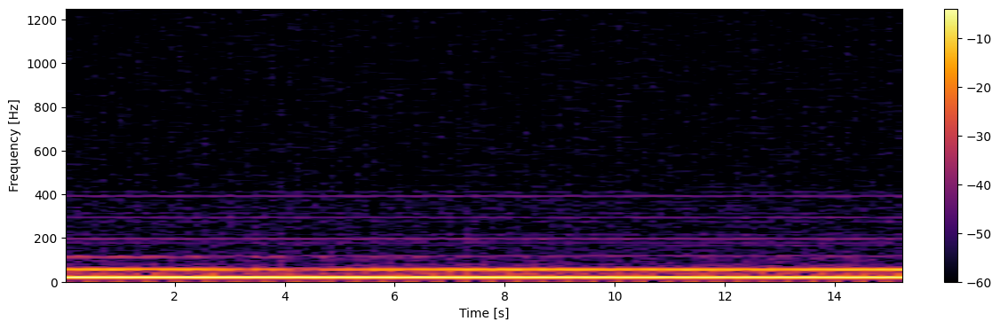

**2_still.tsv** *(X axis, Fundamental = 20.3529 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


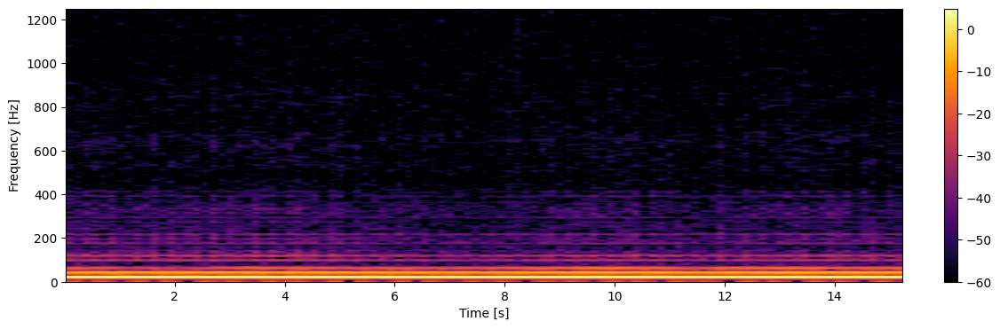

**3_still.tsv** *(X axis, Fundamental = 21.9890 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


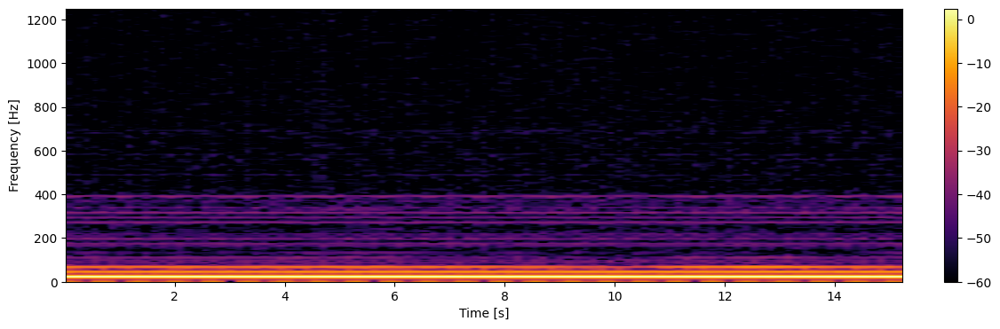

**1_up.tsv** *(X axis, Fundamental = 18.5205 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


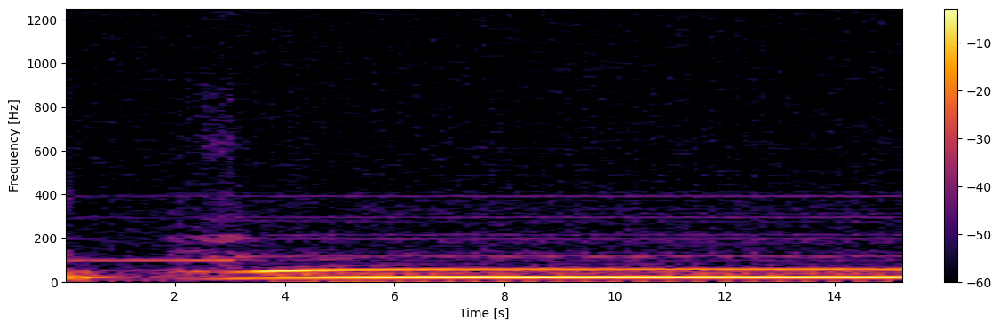

**2_up.tsv** *(X axis, Fundamental = 20.4183 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


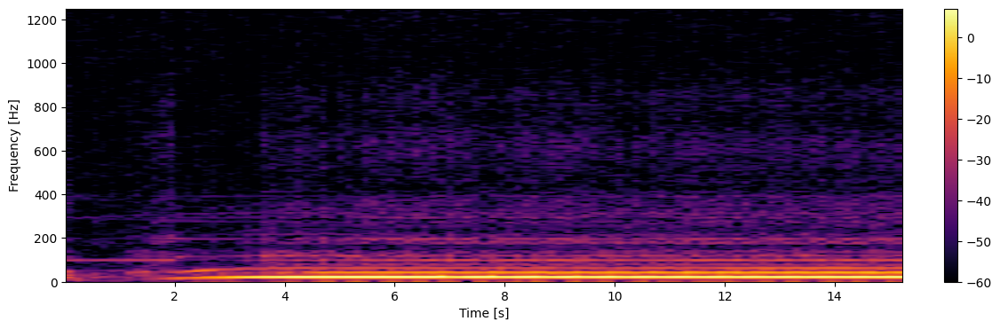

**3_up.tsv** *(X axis, Fundamental = 22.0544 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


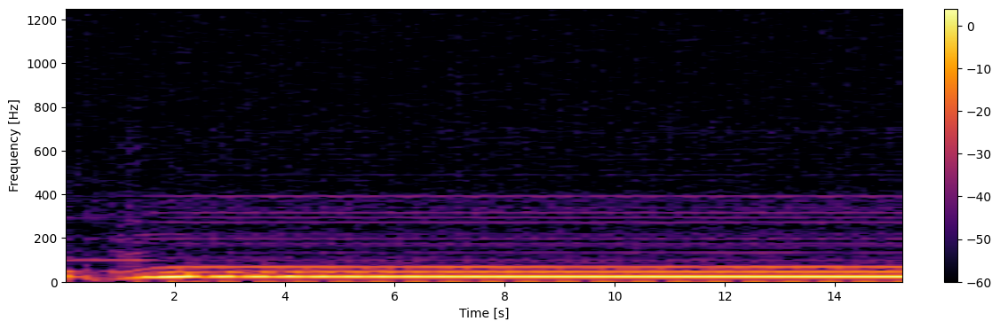

**1_down.tsv** *(X axis, Fundamental = 17.2116 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


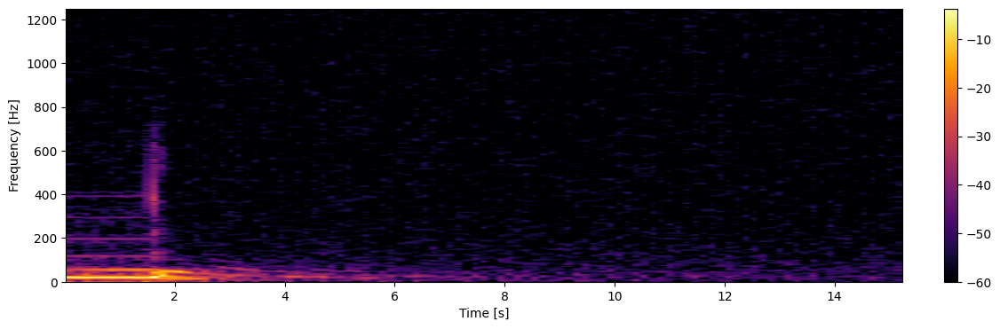

**2_down.tsv** *(X axis, Fundamental = 20.3529 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


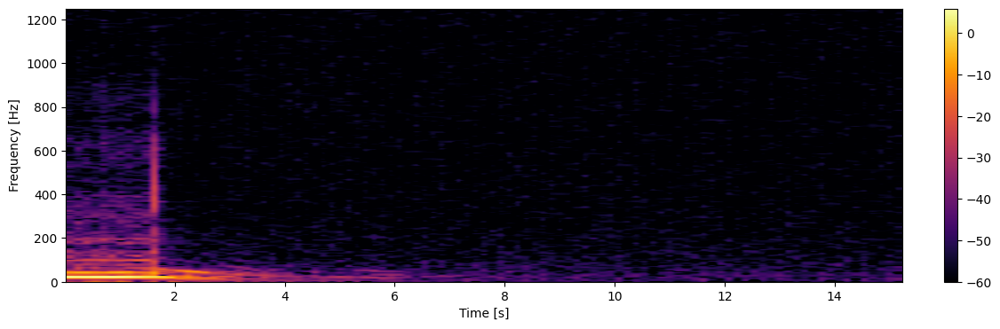

**3_down.tsv** *(X axis, Fundamental = 21.4000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


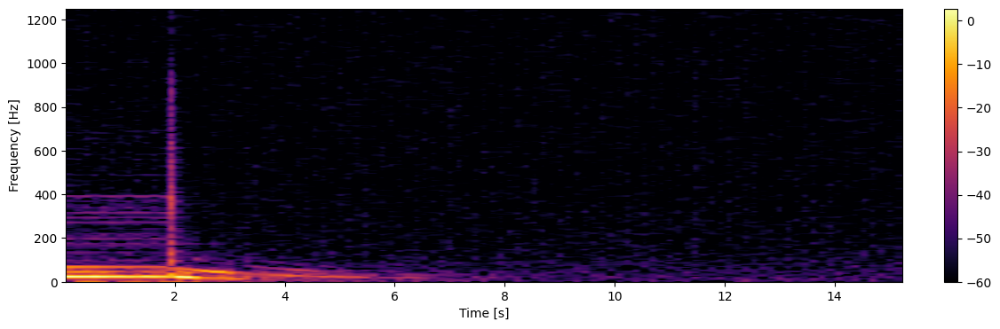

In [35]:
x_spectra = get_spectrograms(DATASET, 'x')

Spectrogram detail in X axis

**1_still.tsv** (X axis @ 5s)

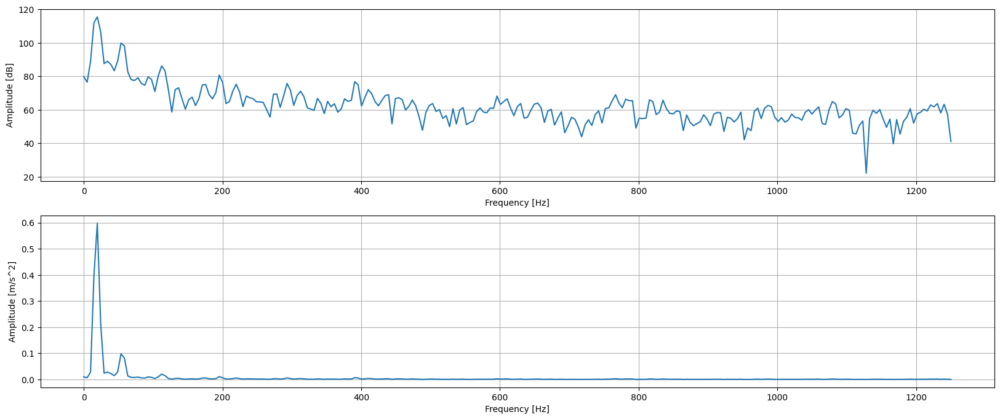

**2_still.tsv** (X axis @ 5s)

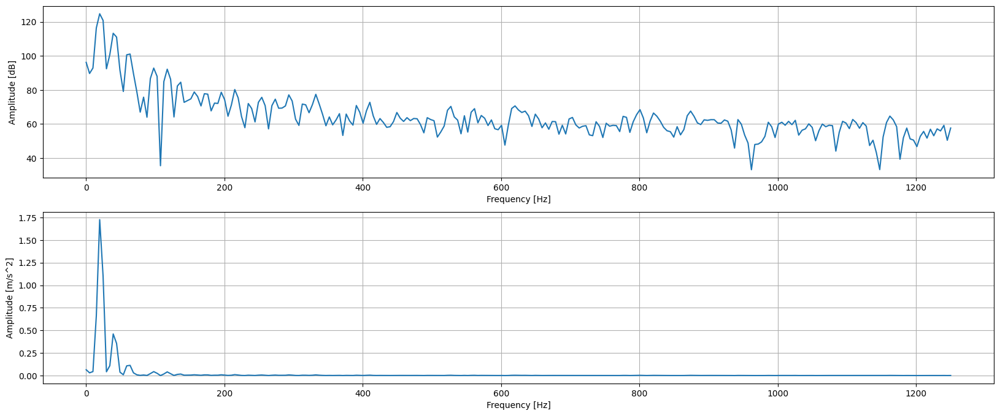

**3_still.tsv** (X axis @ 5s)

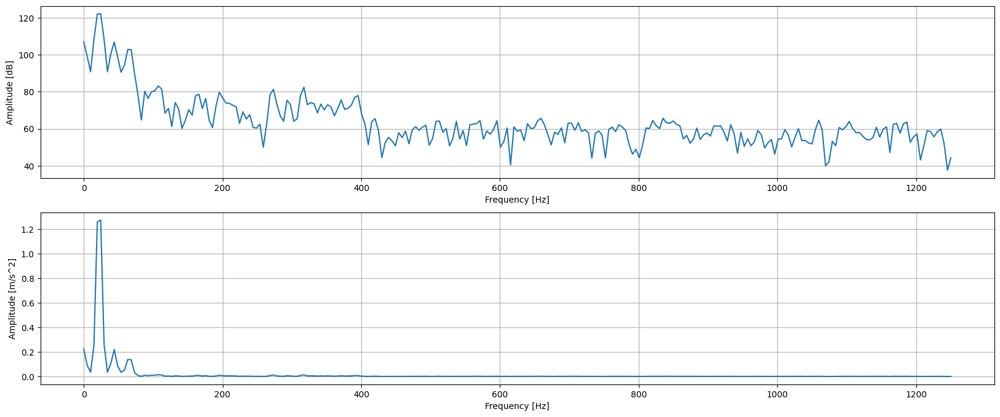

**1_up.tsv** (X axis @ 5s)

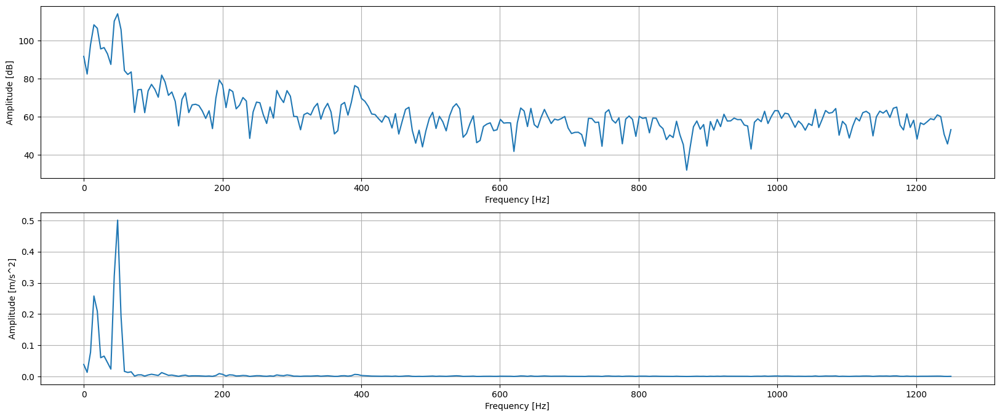

**2_up.tsv** (X axis @ 5s)

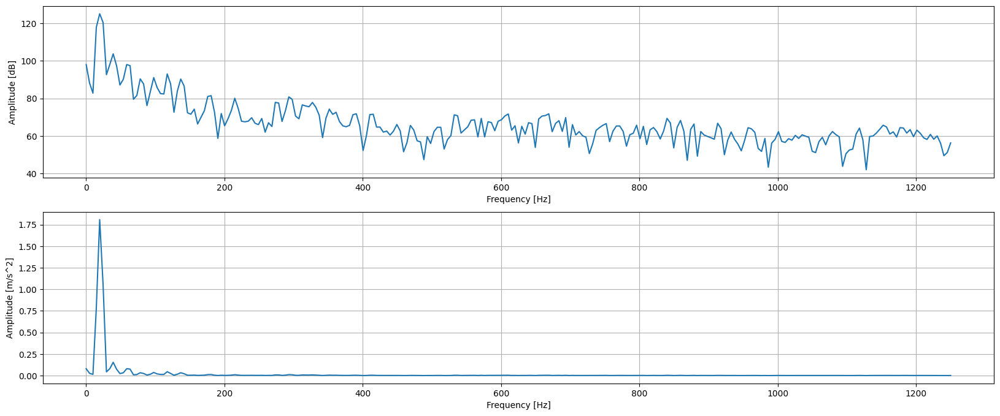

**3_up.tsv** (X axis @ 5s)

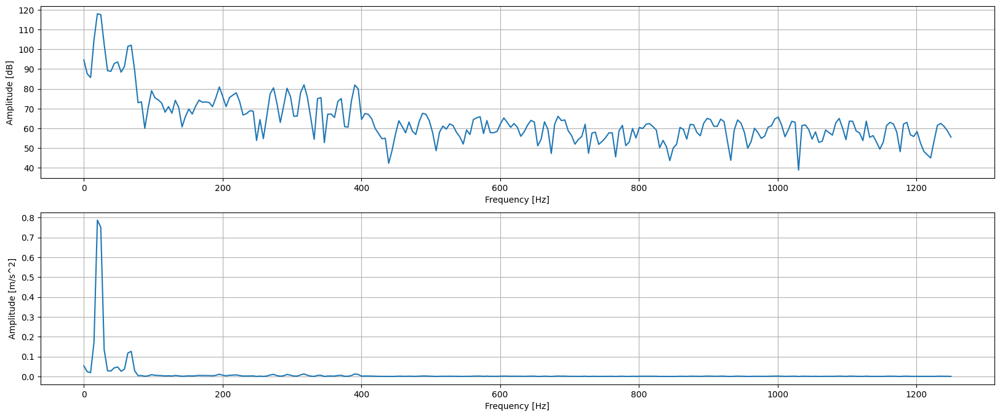

**1_down.tsv** (X axis @ 5s)

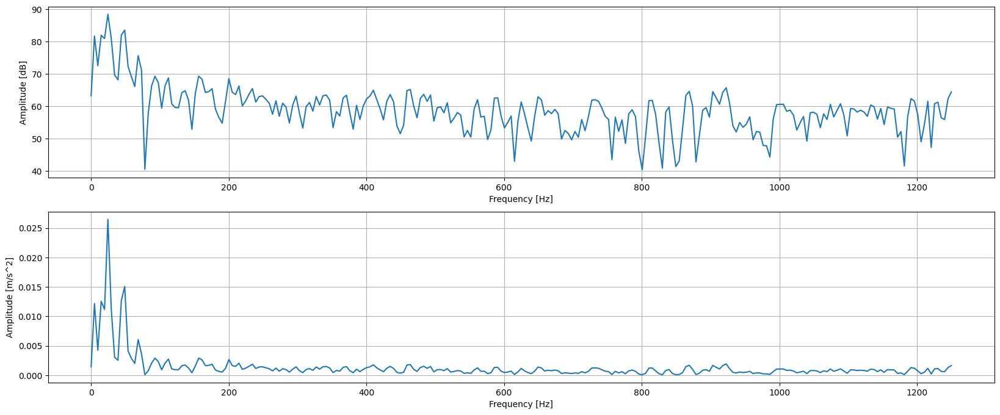

**2_down.tsv** (X axis @ 5s)

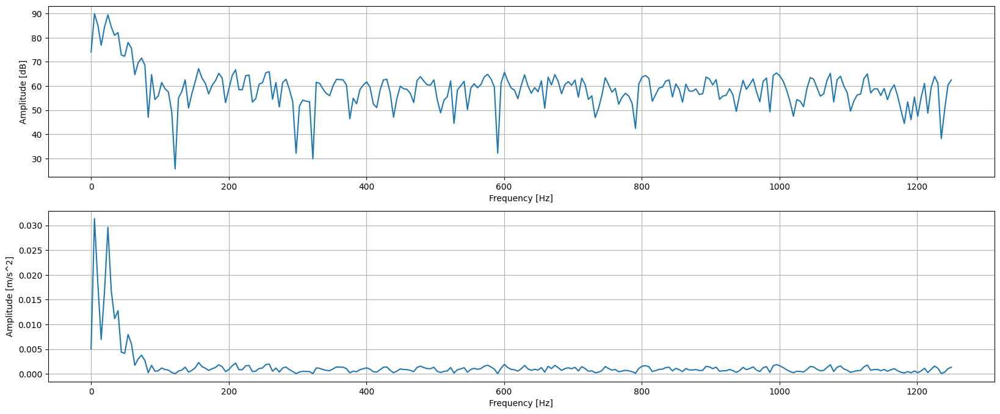

**3_down.tsv** (X axis @ 5s)

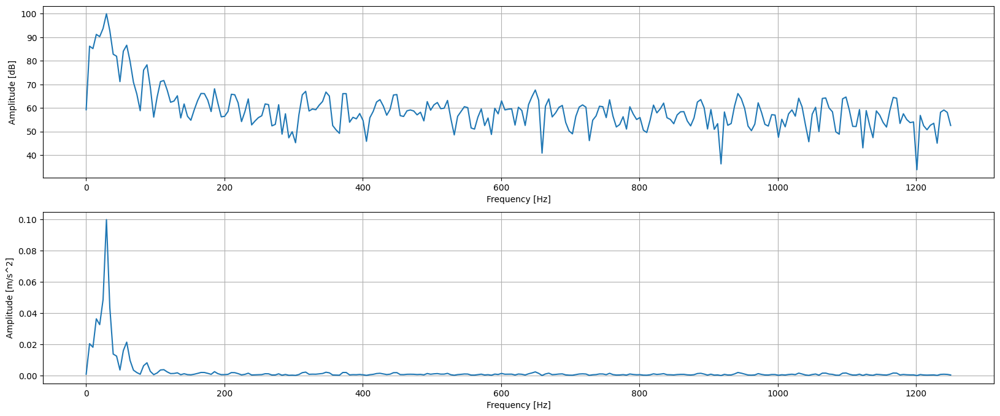

In [36]:
show_spectrogram_detail(x_spectra, 'x', T_SEC)

Peaks in frequency spectrum in X axis
- MMS peak finder algorithm

**1_still.tsv** (X axis @ 5s)

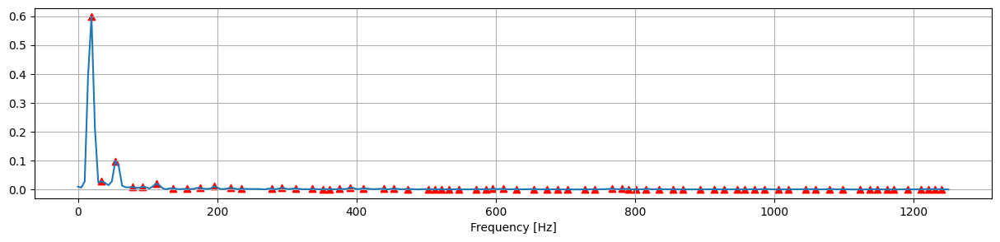

**2_still.tsv** (X axis @ 5s)

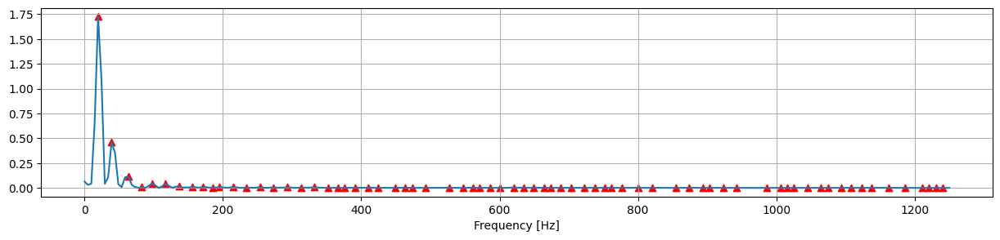

**3_still.tsv** (X axis @ 5s)

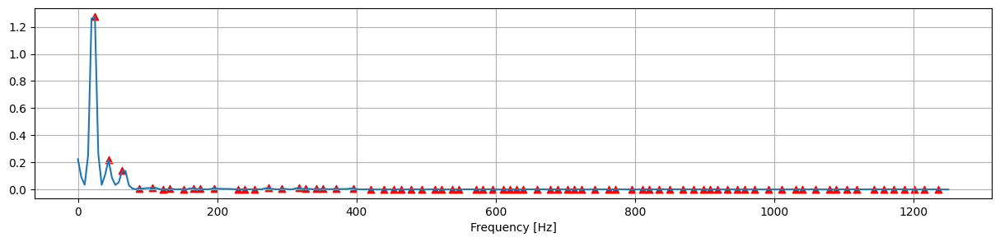

**1_up.tsv** (X axis @ 5s)

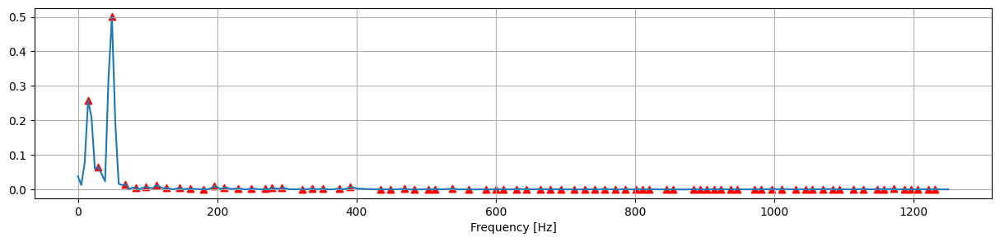

**2_up.tsv** (X axis @ 5s)

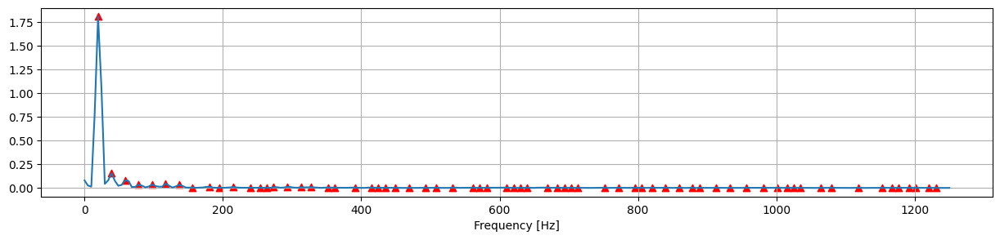

**3_up.tsv** (X axis @ 5s)

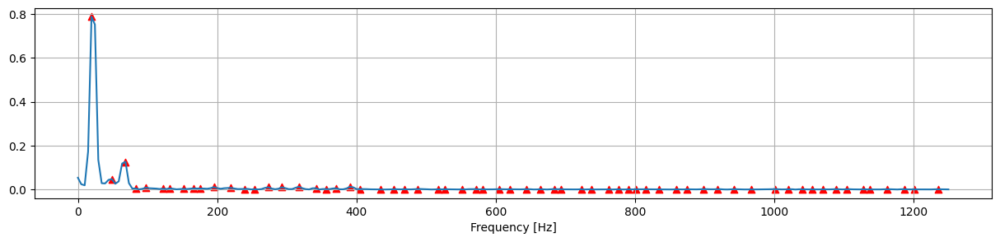

**1_down.tsv** (X axis @ 5s)

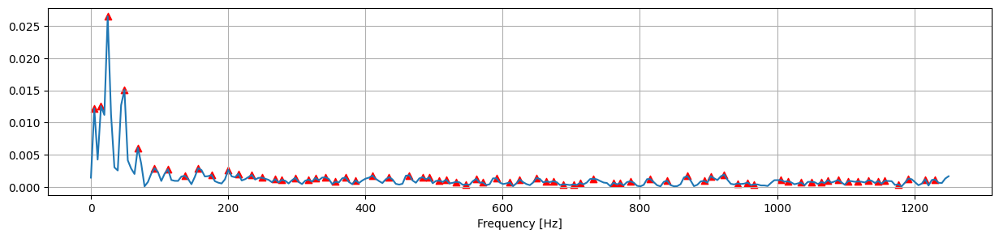

**2_down.tsv** (X axis @ 5s)

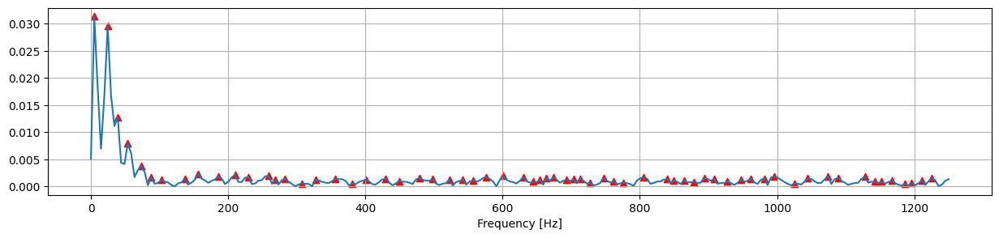

**3_down.tsv** (X axis @ 5s)

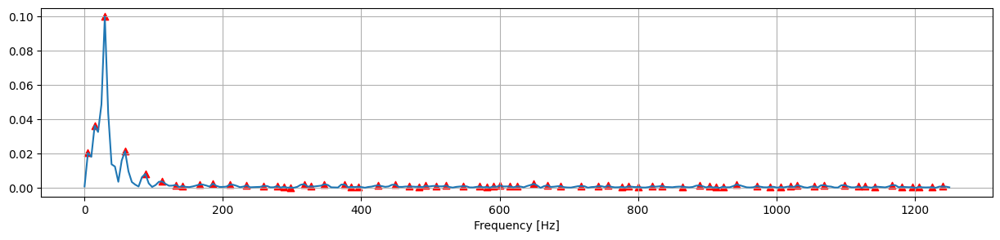

In [37]:
show_mms_peaks(x_spectra, 'x', T_SEC)

Harmonic series detection in X axis

**1_still.tsv** (X axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,0.598242
2,34.1797,0.0281259
3,53.7109,0.0981825
4,78.125,0.00904359
5,92.7734,0.00960221
6,112.305,0.0204995
7,361.328,0.00152038
8,512.695,0.00101309


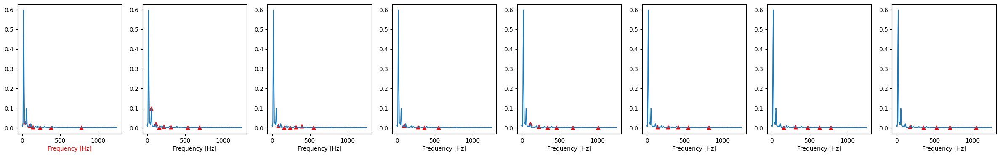

**2_still.tsv** (X axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,1.72634
2,39.0625,0.460627
3,63.4766,0.113223
4,83.0078,0.00612227
5,97.6562,0.0437609
6,170.898,0.00773551
7,473.633,0.0014477
8,703.125,0.00155347


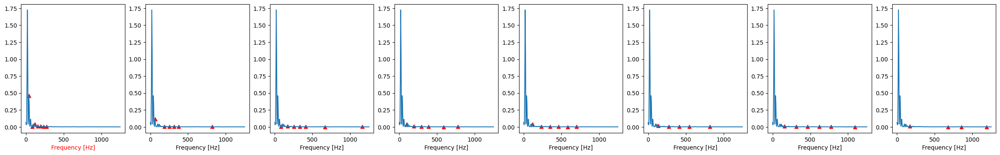

**3_still.tsv** (X axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,24.4141,1.27488
2,43.9453,0.219873
3,63.4766,0.138212
4,87.8906,0.0102777
5,122.07,0.00355465
6,166.016,0.00853154
7,239.258,0.00240824
8,1103.52,0.00157859


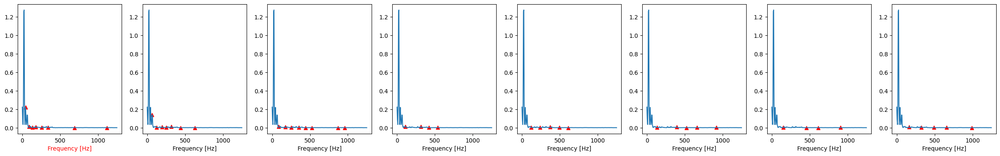

**1_up.tsv** (X axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,14.6484,0.25772
2,29.2969,0.0652615
3,48.8281,0.500745
4,48.8281,0.500745
5,68.3594,0.0150294
6,83.0078,0.00522931
7,97.6562,0.00710395
8,209.961,0.00525951
9,629.883,0.00170622


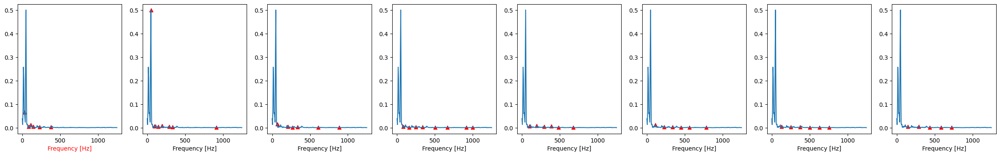

**2_up.tsv** (X axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,1.80747
2,39.0625,0.153841
3,58.5938,0.0798493
4,78.125,0.0331016
5,97.6562,0.0358934
6,263.672,0.00223744
7,361.328,0.00425802
8,703.125,0.00199299


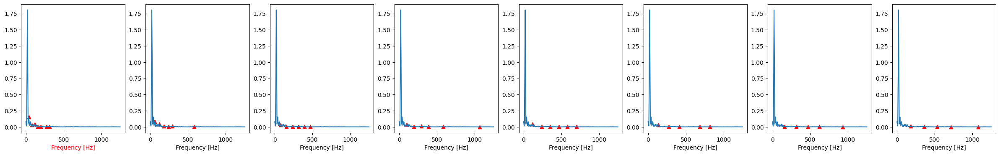

**3_up.tsv** (X axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,0.787065
2,48.8281,0.0476605
3,83.0078,0.00467982
4,97.6562,0.00895048
5,131.836,0.00510151
6,151.367,0.00308231
7,341.797,0.00598421
8,874.023,0.00126419


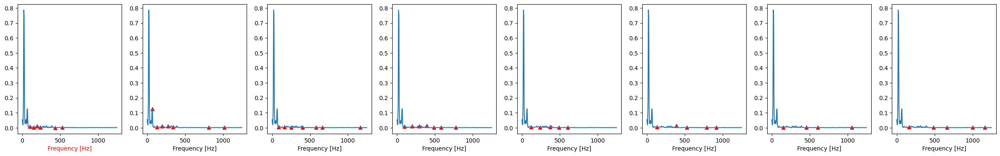

**1_down.tsv** (X axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,4.88281,0.012185
2,4.88281,0.012185
3,14.6484,0.0125539
4,14.6484,0.0125539
5,24.4141,0.0264646
6,24.4141,0.0264646
7,48.8281,0.0150749
8,112.305,0.00275639
9,463.867,0.00182512


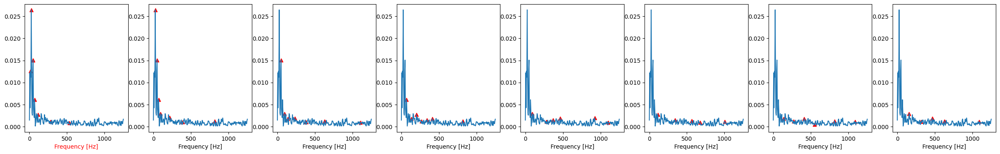

**2_down.tsv** (X axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,4.88281,0.0313852
2,4.88281,0.0313852
3,4.88281,0.0313852
4,24.4141,0.029615
5,24.4141,0.029615
6,39.0625,0.0127637
7,87.8906,0.00171545
8,400.391,0.00121692


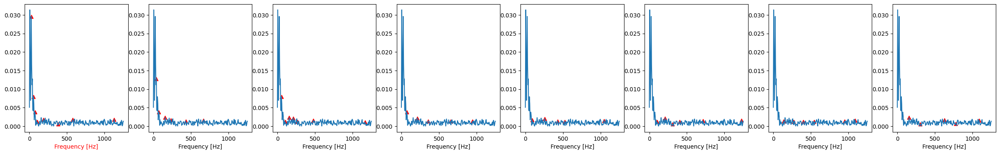

**3_down.tsv** (X axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,4.88281,0.0204595
2,4.88281,0.0204595
3,14.6484,0.0363999
4,14.6484,0.0363999
5,29.2969,0.0999142
6,29.2969,0.0999142
7,87.8906,0.00823027
8,131.836,0.00181124
9,375.977,0.0020119


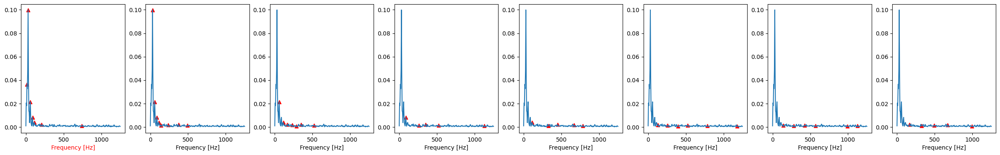

In [38]:
show_harmonic_series(x_spectra, 'x', T_SEC)

In [39]:
show_spectra_largest_amplitudes(x_spectra, 'x', T_SEC)

**1_still.tsv** (X axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,0.598242,1
1,92.7734,0.00960221,4.75
2,175.781,0.00570918,9
3,439.453,0.00283587,22.5
4,454.102,0.0023033,23.25


**2_still.tsv** (X axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,1.72634,1
1,136.719,0.0168433,7
2,332.031,0.00742667,17
3,410.156,0.00432779,21
4,527.344,0.00327741,27


**3_still.tsv** (X axis @ 5s)

- *Fundamental frequency:* 24.4140625 Hz

,f,y,1x
0,24.4141,1.27488,1
1,273.438,0.011623,11.2
2,371.094,0.00599405,15.2
3,229.492,0.00286814,9.4
4,820.312,0.0016745,33.6


**1_up.tsv** (X axis @ 5s)

- *Fundamental frequency:* 48.828125 Hz

,f,y,1x
0,48.8281,0.500745,1
1,195.312,0.00924016,4
2,278.32,0.00491589,5.7
3,249.023,0.00243771,5.1
4,161.133,0.00214016,3.3


**2_up.tsv** (X axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,1.80747,1
1,78.125,0.0331016,4
2,273.438,0.00783417,14
3,195.312,0.00395028,10
4,532.227,0.00364328,27.25


**3_up.tsv** (X axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,0.787065,1
1,195.312,0.0111635,10
2,341.797,0.00598421,17.5
3,151.367,0.00308231,7.75
4,683.594,0.00202092,35


**1_down.tsv** (X axis @ 5s)

- *Fundamental frequency:* 24.4140625 Hz

,f,y,1x
0,24.4141,0.0264646,1
1,92.7734,0.0029218,3.8
2,234.375,0.00188239,9.6
3,869.141,0.00170404,35.6
4,371.094,0.00148867,15.2


**2_down.tsv** (X axis @ 5s)

- *Fundamental frequency:* 4.8828125 Hz

,f,y,1x
0,4.88281,0.0313852,1
1,156.25,0.00228919,32
2,185.547,0.00183081,38
3,87.8906,0.00171545,18
4,1225.59,0.0015785,251


**3_down.tsv** (X axis @ 5s)

- *Fundamental frequency:* 29.296875 Hz

,f,y,1x
0,29.2969,0.0999142,1
1,185.547,0.00255029,6.33333
2,942.383,0.00202025,32.1667
3,1098.63,0.00170369,37.5
4,234.375,0.00155523,8


Spectrogram in Y axis

**1_still.tsv** *(Y axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


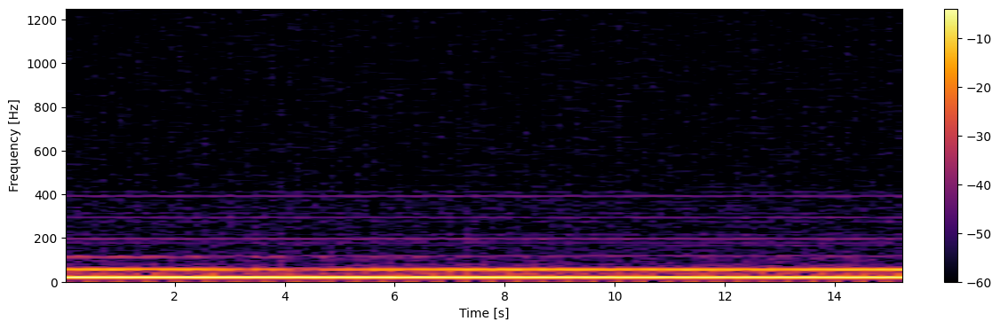

**2_still.tsv** *(Y axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


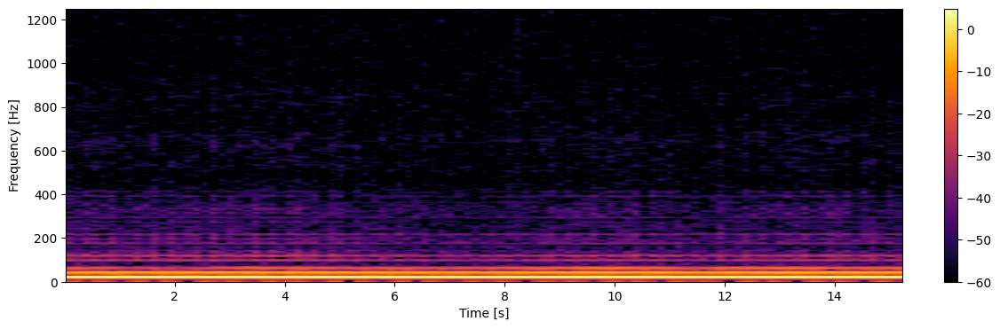

**3_still.tsv** *(Y axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


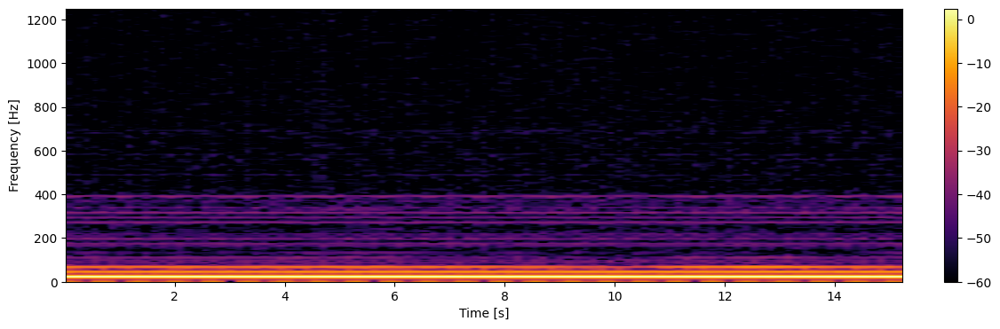

**1_up.tsv** *(Y axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


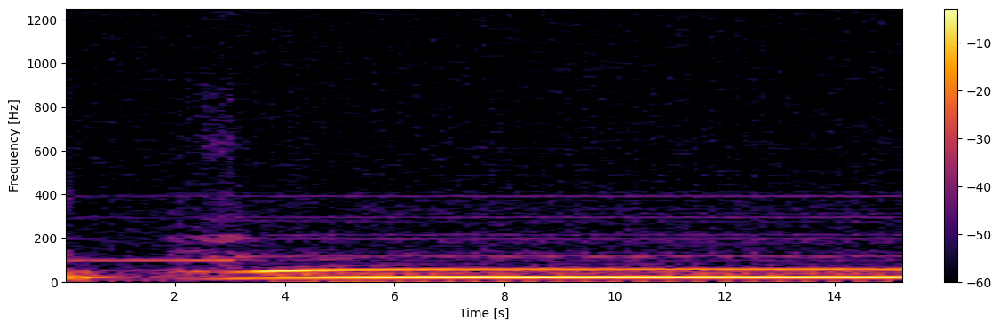

**2_up.tsv** *(Y axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


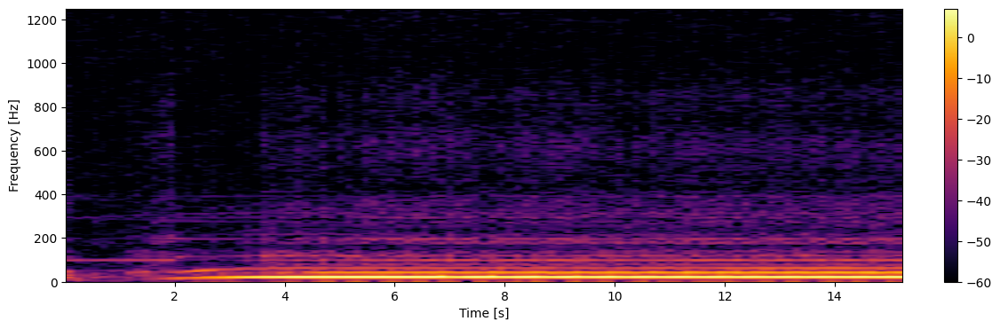

**3_up.tsv** *(Y axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


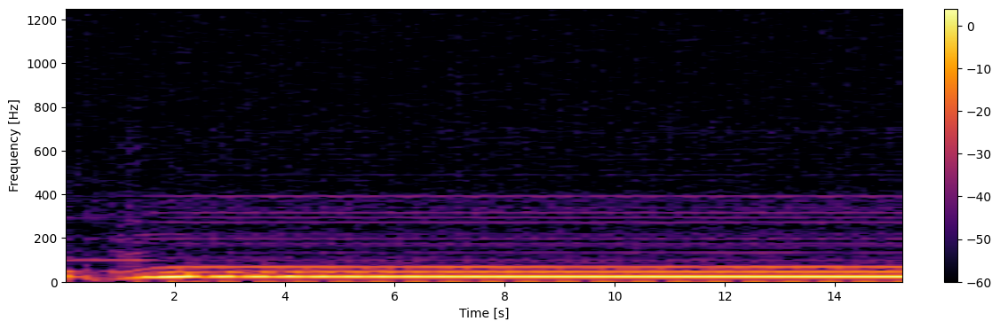

**1_down.tsv** *(Y axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


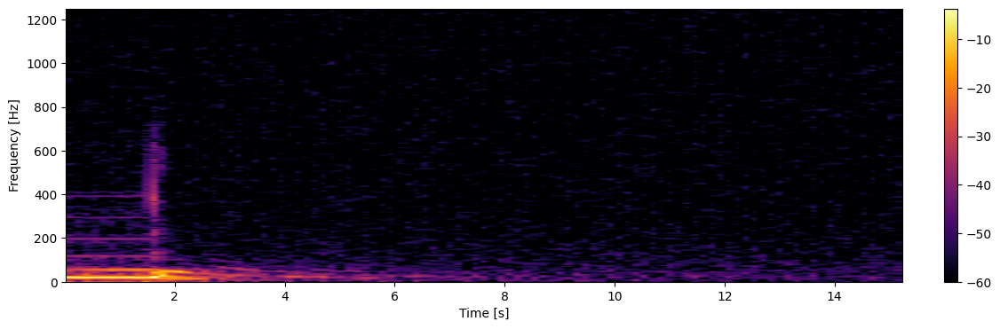

**2_down.tsv** *(Y axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


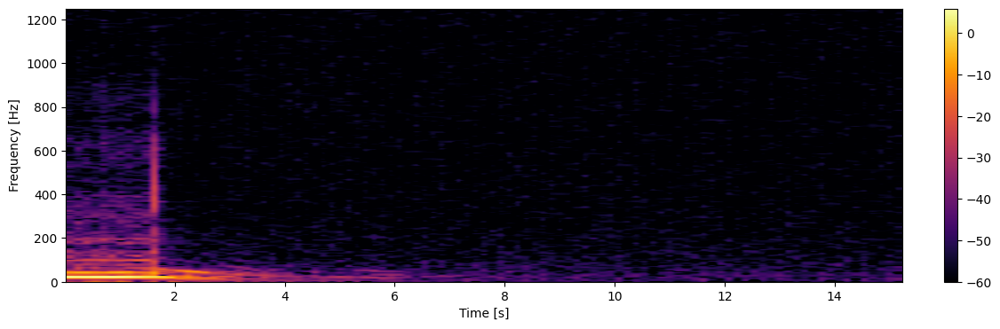

**3_down.tsv** *(Y axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


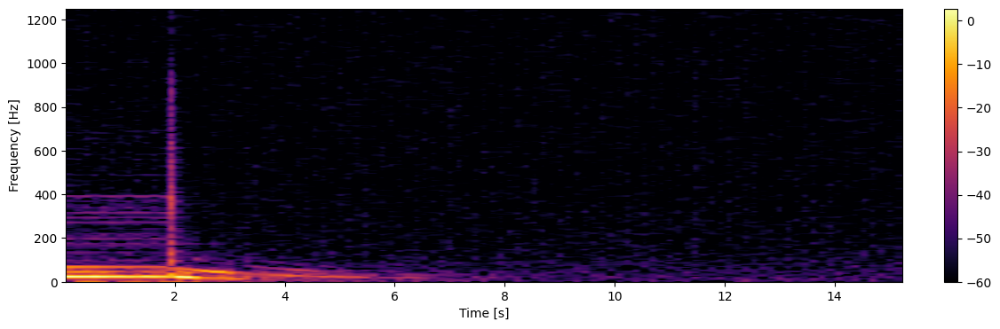

In [40]:
y_spectra = get_spectrograms(DATASET, 'y')

Spectrogram detail in Y axis

**1_still.tsv** (Y axis @ 5s)

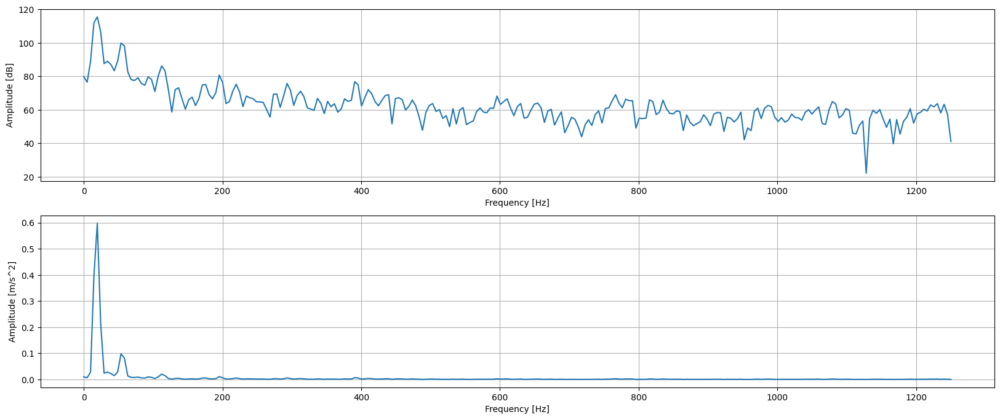

**2_still.tsv** (Y axis @ 5s)

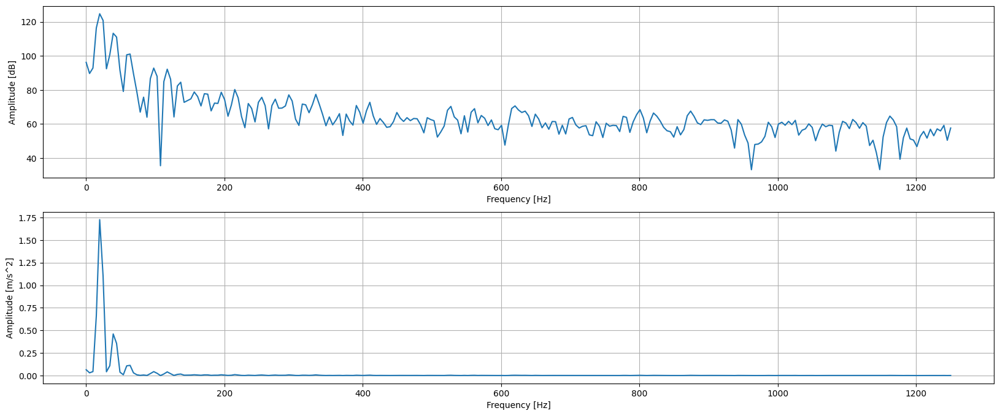

**3_still.tsv** (Y axis @ 5s)

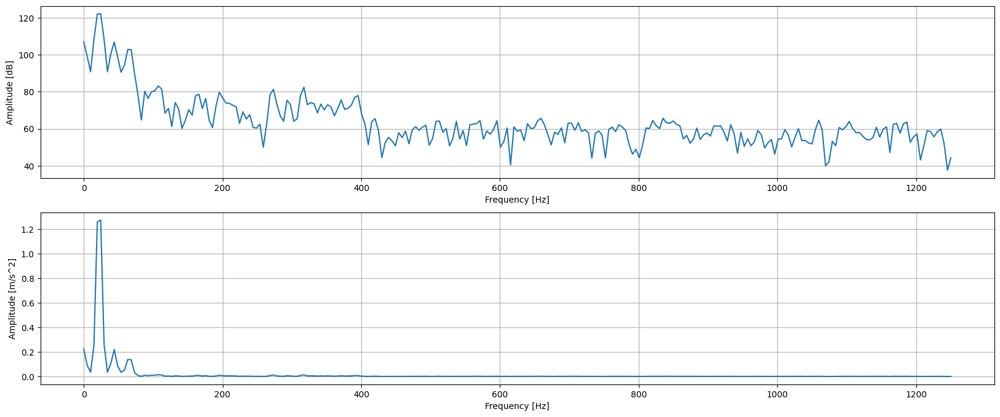

**1_up.tsv** (Y axis @ 5s)

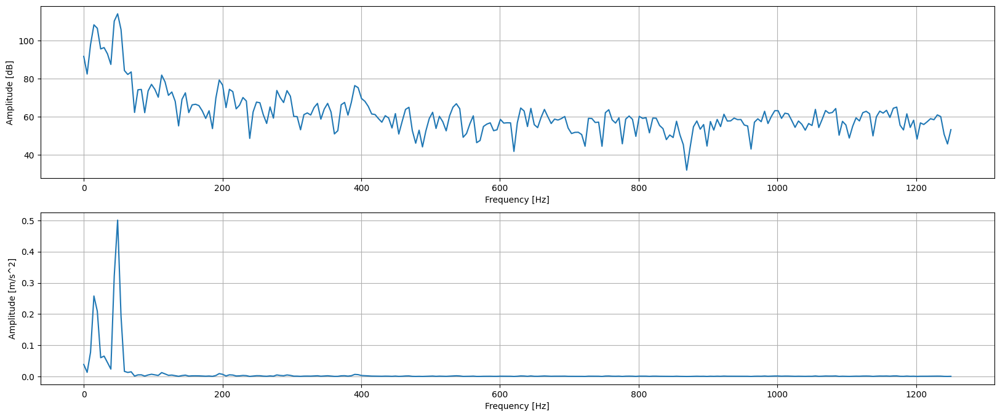

**2_up.tsv** (Y axis @ 5s)

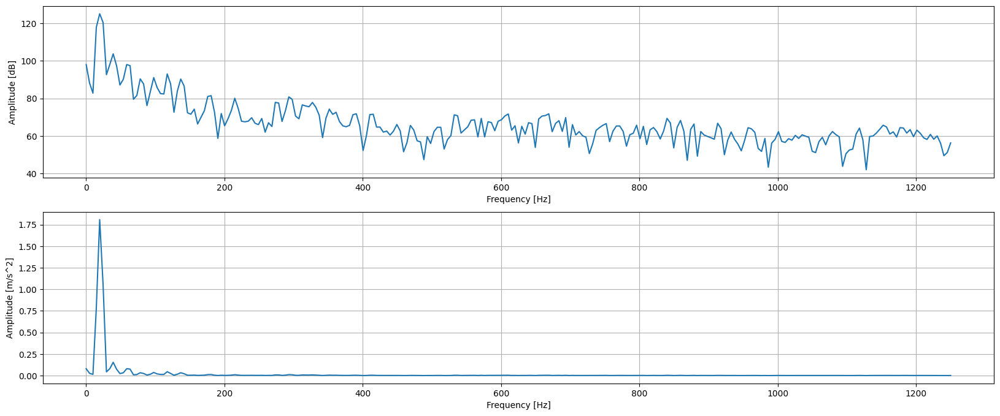

**3_up.tsv** (Y axis @ 5s)

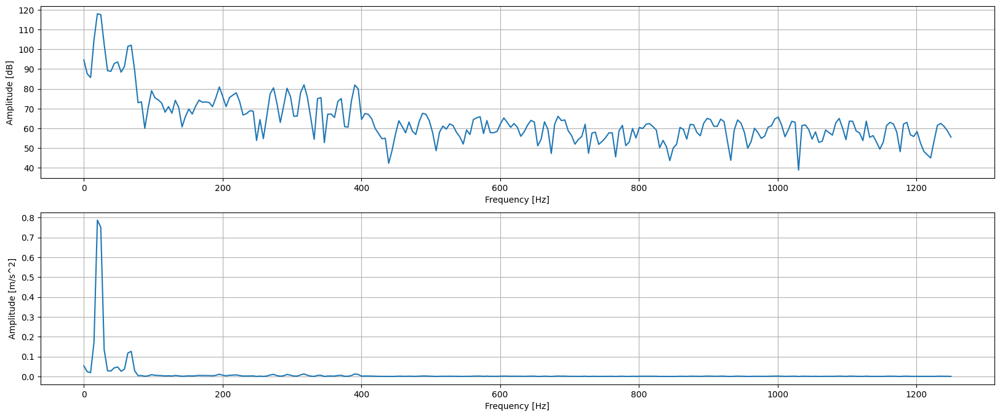

**1_down.tsv** (Y axis @ 5s)

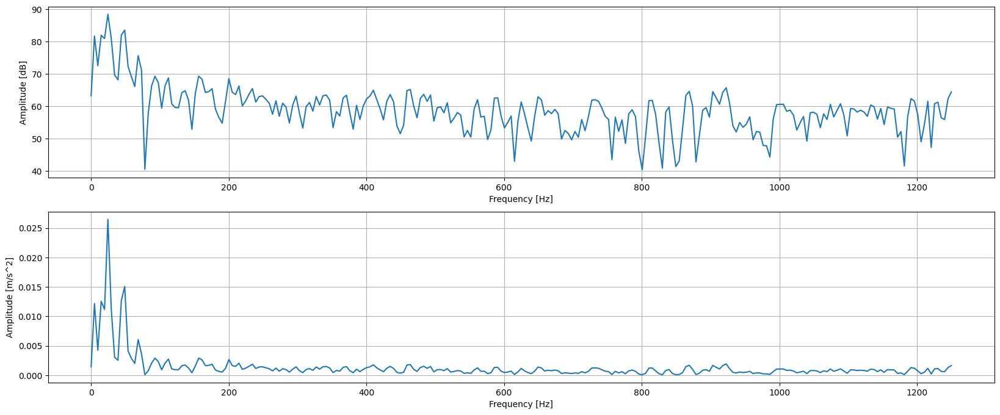

**2_down.tsv** (Y axis @ 5s)

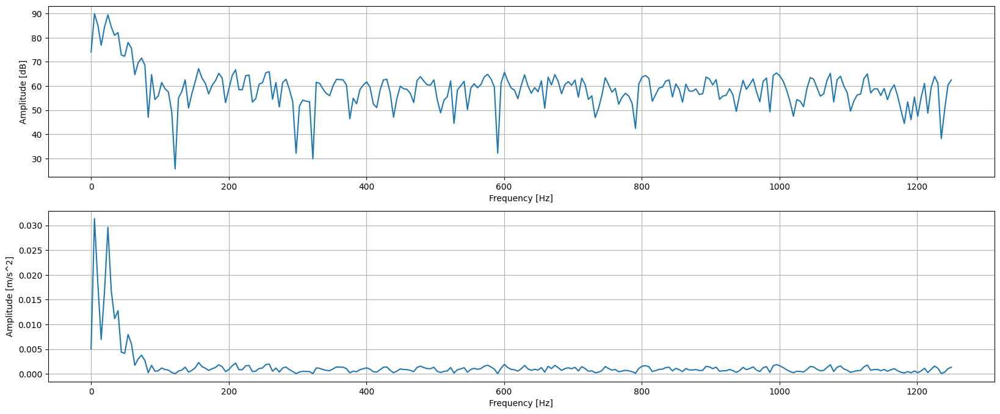

**3_down.tsv** (Y axis @ 5s)

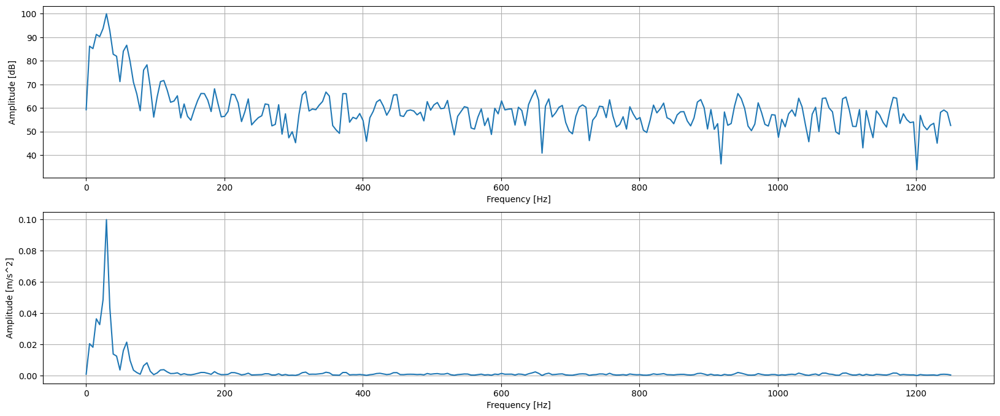

In [41]:
show_spectrogram_detail(y_spectra, 'y', T_SEC)

Peaks in frequency spectrum in Y axis

**1_still.tsv** (Y axis @ 5s)

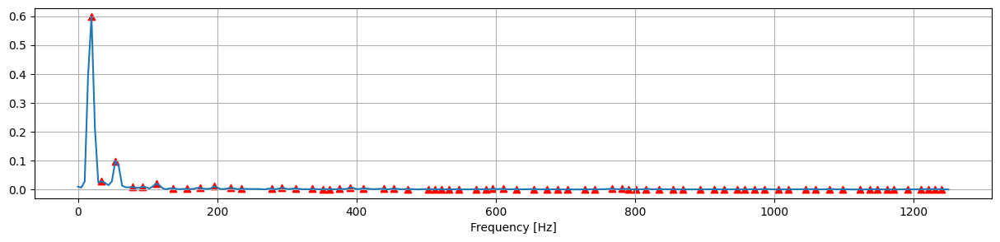

**2_still.tsv** (Y axis @ 5s)

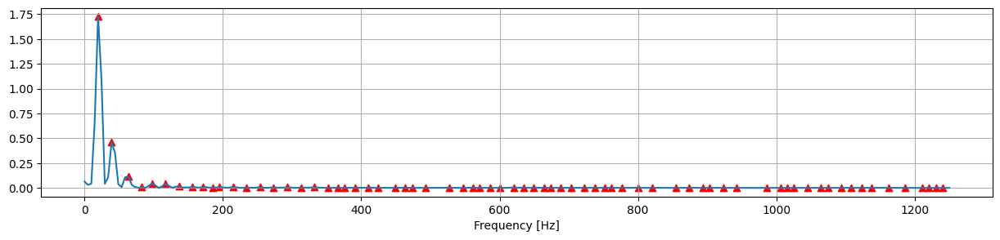

**3_still.tsv** (Y axis @ 5s)

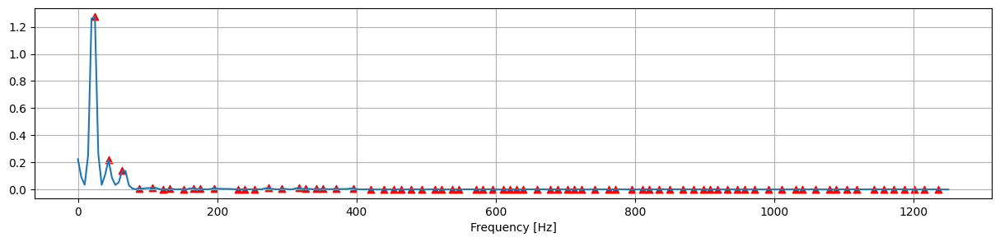

**1_up.tsv** (Y axis @ 5s)

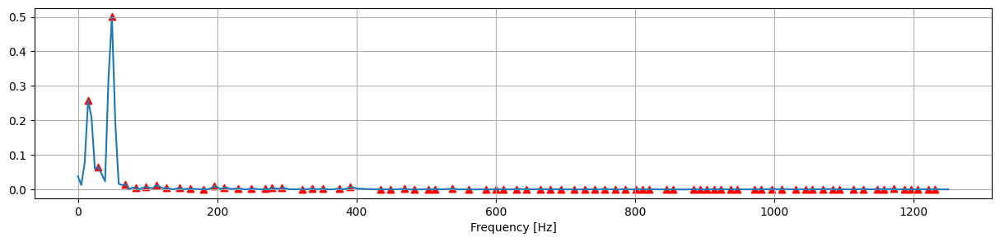

**2_up.tsv** (Y axis @ 5s)

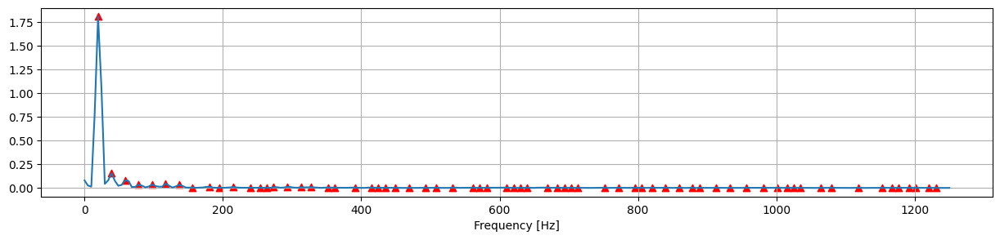

**3_up.tsv** (Y axis @ 5s)

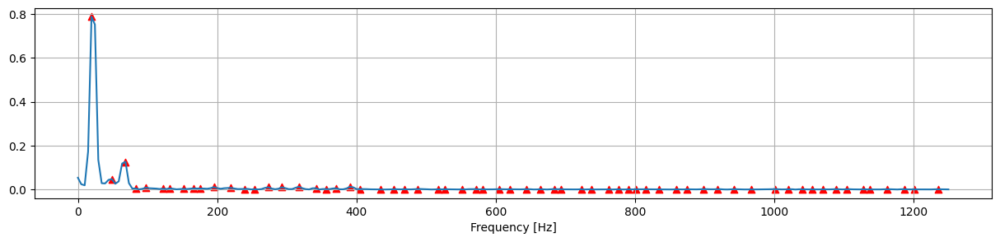

**1_down.tsv** (Y axis @ 5s)

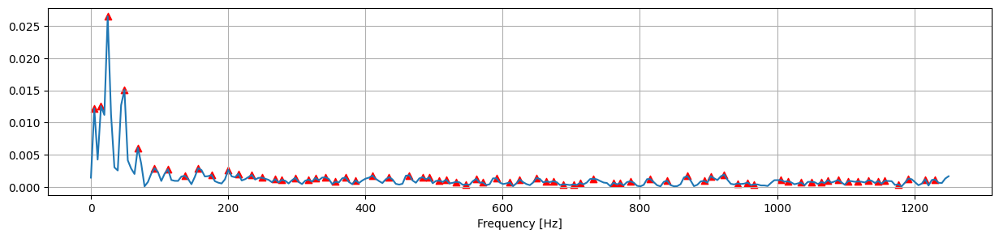

**2_down.tsv** (Y axis @ 5s)

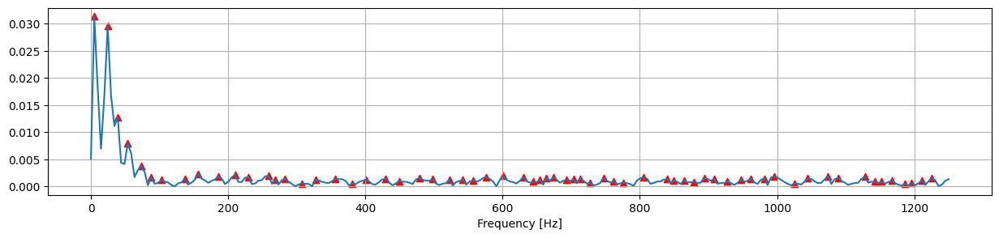

**3_down.tsv** (Y axis @ 5s)

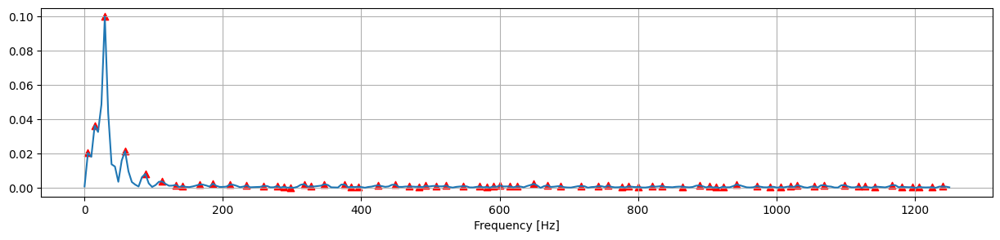

In [42]:
show_mms_peaks(y_spectra, 'y', T_SEC)

Harmonic series detection in Y axis

**1_still.tsv** (Y axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,0.598242
2,34.1797,0.0281259
3,53.7109,0.0981825
4,78.125,0.00904359
5,92.7734,0.00960221
6,112.305,0.0204995
7,361.328,0.00152038
8,512.695,0.00101309


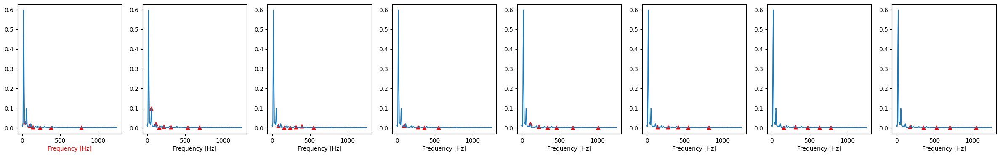

**2_still.tsv** (Y axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,1.72634
2,39.0625,0.460627
3,63.4766,0.113223
4,83.0078,0.00612227
5,97.6562,0.0437609
6,170.898,0.00773551
7,473.633,0.0014477
8,703.125,0.00155347


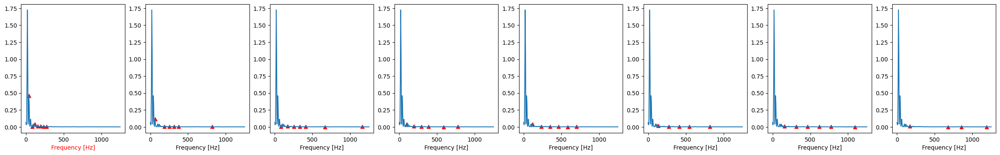

**3_still.tsv** (Y axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,24.4141,1.27488
2,43.9453,0.219873
3,63.4766,0.138212
4,87.8906,0.0102777
5,122.07,0.00355465
6,166.016,0.00853154
7,239.258,0.00240824
8,1103.52,0.00157859


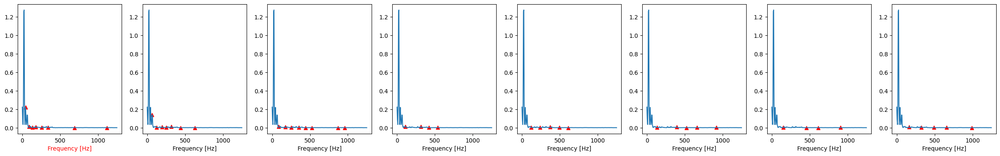

**1_up.tsv** (Y axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,14.6484,0.25772
2,29.2969,0.0652615
3,48.8281,0.500745
4,48.8281,0.500745
5,68.3594,0.0150294
6,83.0078,0.00522931
7,97.6562,0.00710395
8,209.961,0.00525951
9,629.883,0.00170622


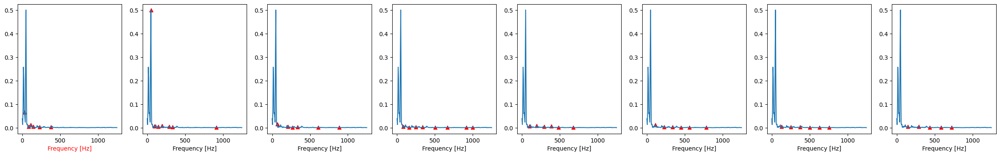

**2_up.tsv** (Y axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,1.80747
2,39.0625,0.153841
3,58.5938,0.0798493
4,78.125,0.0331016
5,97.6562,0.0358934
6,263.672,0.00223744
7,361.328,0.00425802
8,703.125,0.00199299


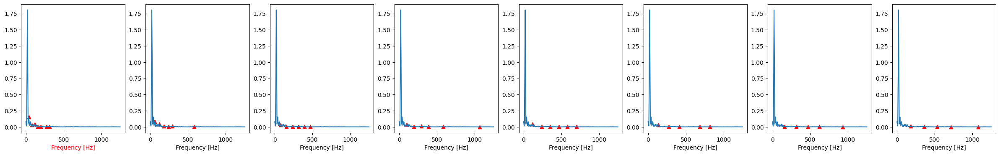

**3_up.tsv** (Y axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,0.787065
2,48.8281,0.0476605
3,83.0078,0.00467982
4,97.6562,0.00895048
5,131.836,0.00510151
6,151.367,0.00308231
7,341.797,0.00598421
8,874.023,0.00126419


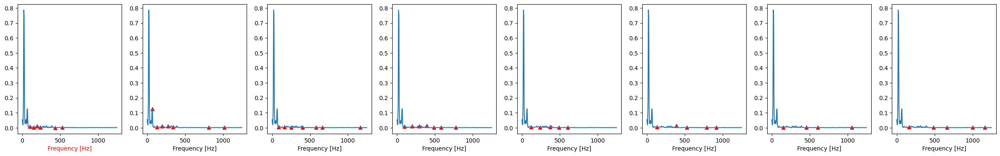

**1_down.tsv** (Y axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,4.88281,0.012185
2,4.88281,0.012185
3,14.6484,0.0125539
4,14.6484,0.0125539
5,24.4141,0.0264646
6,24.4141,0.0264646
7,48.8281,0.0150749
8,112.305,0.00275639
9,463.867,0.00182512


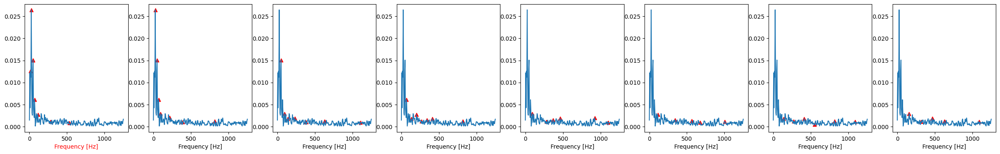

**2_down.tsv** (Y axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,4.88281,0.0313852
2,4.88281,0.0313852
3,4.88281,0.0313852
4,24.4141,0.029615
5,24.4141,0.029615
6,39.0625,0.0127637
7,87.8906,0.00171545
8,400.391,0.00121692


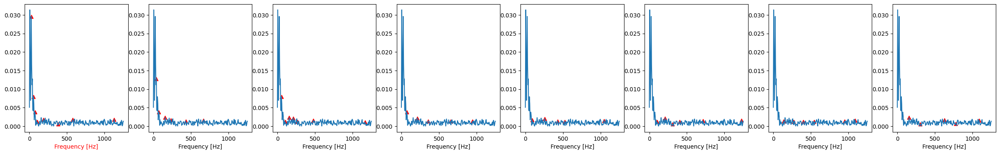

**3_down.tsv** (Y axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,4.88281,0.0204595
2,4.88281,0.0204595
3,14.6484,0.0363999
4,14.6484,0.0363999
5,29.2969,0.0999142
6,29.2969,0.0999142
7,87.8906,0.00823027
8,131.836,0.00181124
9,375.977,0.0020119


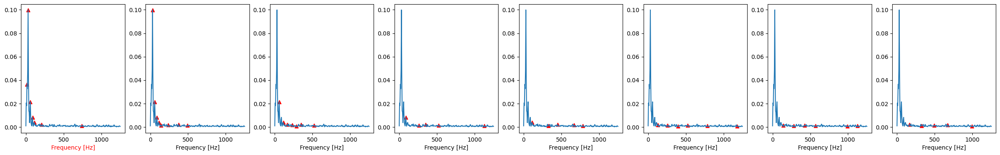

In [43]:
show_harmonic_series(y_spectra, 'y', T_SEC)

In [44]:
show_spectra_largest_amplitudes(y_spectra, 'y', T_SEC)

**1_still.tsv** (Y axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,0.598242,1
1,92.7734,0.00960221,4.75
2,175.781,0.00570918,9
3,439.453,0.00283587,22.5
4,454.102,0.0023033,23.25


**2_still.tsv** (Y axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,1.72634,1
1,136.719,0.0168433,7
2,332.031,0.00742667,17
3,410.156,0.00432779,21
4,527.344,0.00327741,27


**3_still.tsv** (Y axis @ 5s)

- *Fundamental frequency:* 24.4140625 Hz

,f,y,1x
0,24.4141,1.27488,1
1,273.438,0.011623,11.2
2,371.094,0.00599405,15.2
3,229.492,0.00286814,9.4
4,820.312,0.0016745,33.6


**1_up.tsv** (Y axis @ 5s)

- *Fundamental frequency:* 48.828125 Hz

,f,y,1x
0,48.8281,0.500745,1
1,195.312,0.00924016,4
2,278.32,0.00491589,5.7
3,249.023,0.00243771,5.1
4,161.133,0.00214016,3.3


**2_up.tsv** (Y axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,1.80747,1
1,78.125,0.0331016,4
2,273.438,0.00783417,14
3,195.312,0.00395028,10
4,532.227,0.00364328,27.25


**3_up.tsv** (Y axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,0.787065,1
1,195.312,0.0111635,10
2,341.797,0.00598421,17.5
3,151.367,0.00308231,7.75
4,683.594,0.00202092,35


**1_down.tsv** (Y axis @ 5s)

- *Fundamental frequency:* 24.4140625 Hz

,f,y,1x
0,24.4141,0.0264646,1
1,92.7734,0.0029218,3.8
2,234.375,0.00188239,9.6
3,869.141,0.00170404,35.6
4,371.094,0.00148867,15.2


**2_down.tsv** (Y axis @ 5s)

- *Fundamental frequency:* 4.8828125 Hz

,f,y,1x
0,4.88281,0.0313852,1
1,156.25,0.00228919,32
2,185.547,0.00183081,38
3,87.8906,0.00171545,18
4,1225.59,0.0015785,251


**3_down.tsv** (Y axis @ 5s)

- *Fundamental frequency:* 29.296875 Hz

,f,y,1x
0,29.2969,0.0999142,1
1,185.547,0.00255029,6.33333
2,942.383,0.00202025,32.1667
3,1098.63,0.00170369,37.5
4,234.375,0.00155523,8


Spectrogram in Z axis

**1_still.tsv** *(Z axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


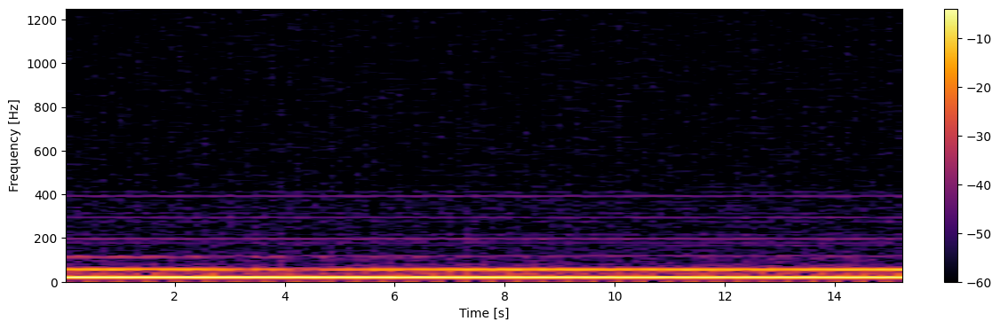

**2_still.tsv** *(Z axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


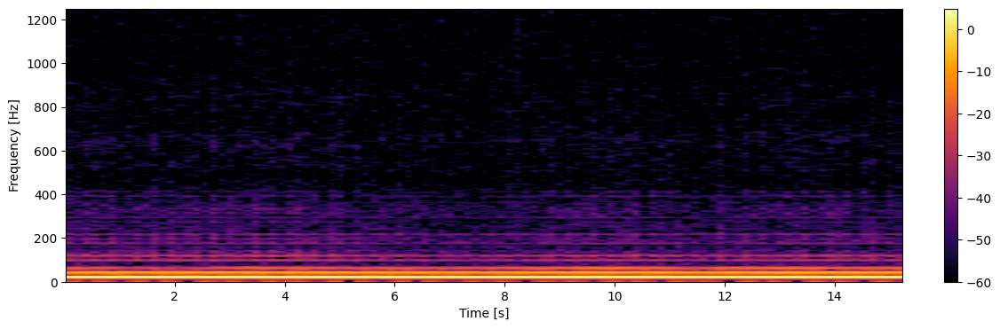

**3_still.tsv** *(Z axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


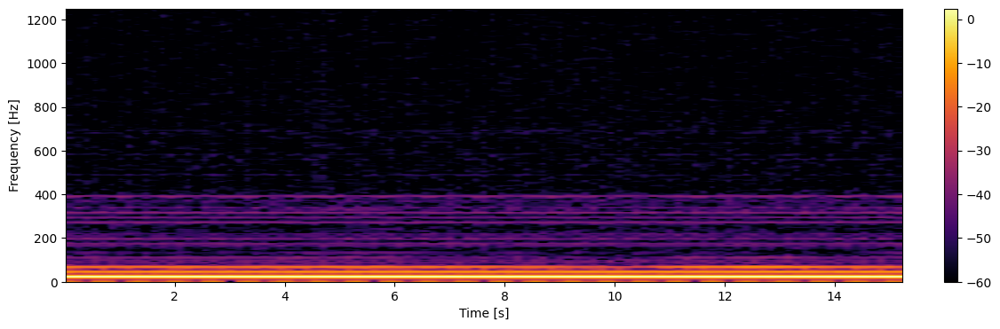

**1_up.tsv** *(Z axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


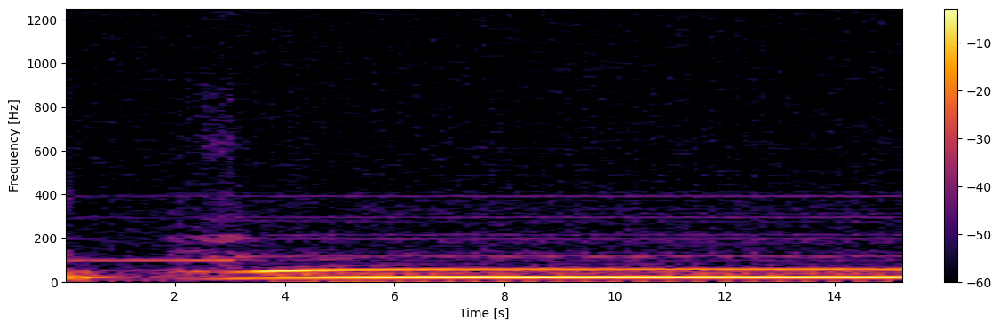

**2_up.tsv** *(Z axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


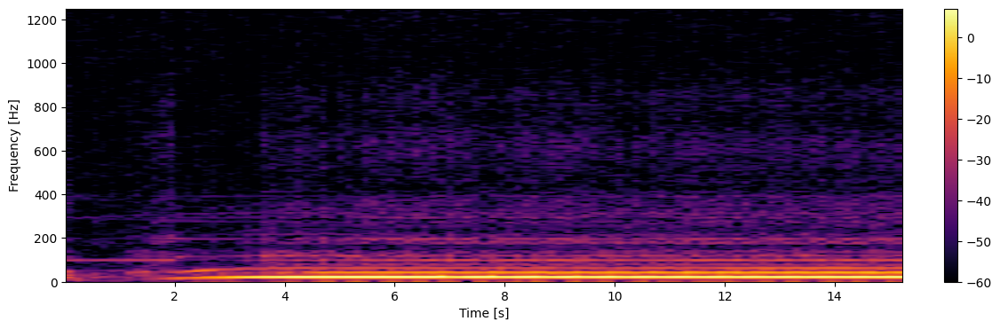

**3_up.tsv** *(Z axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


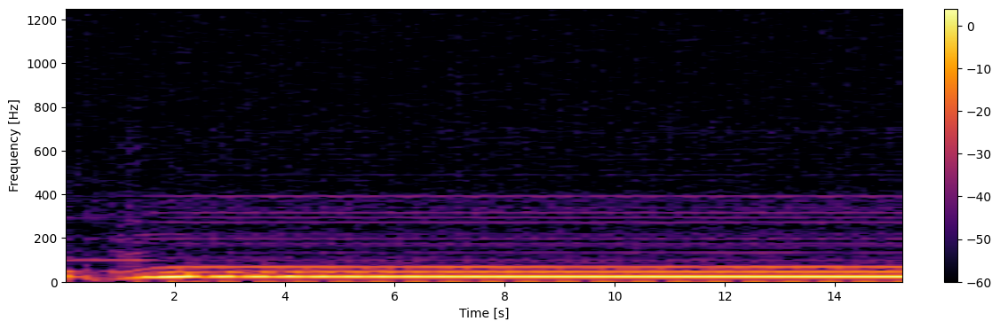

**1_down.tsv** *(Z axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


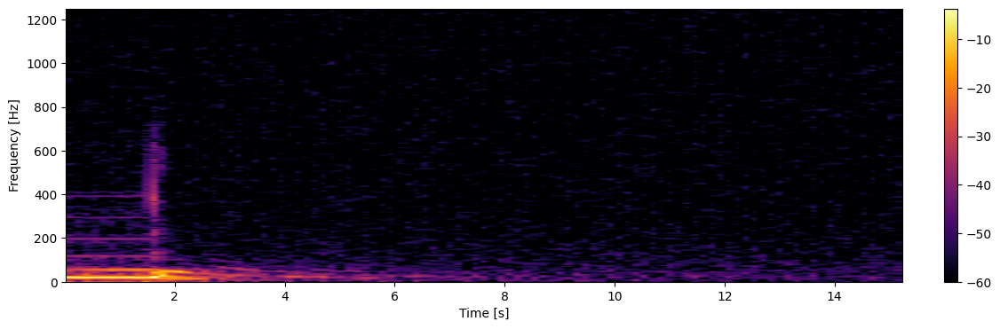

**2_down.tsv** *(Z axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


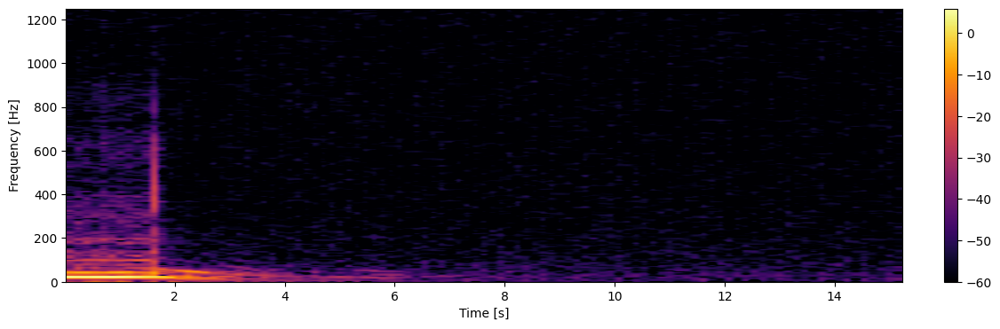

**3_down.tsv** *(Z axis, Fundamental = 0.0000 Hz)*

Window size: 512
Heinsenberg box
	Time step: 204.8 ms
	Frequency step: 4.8828125 Hz


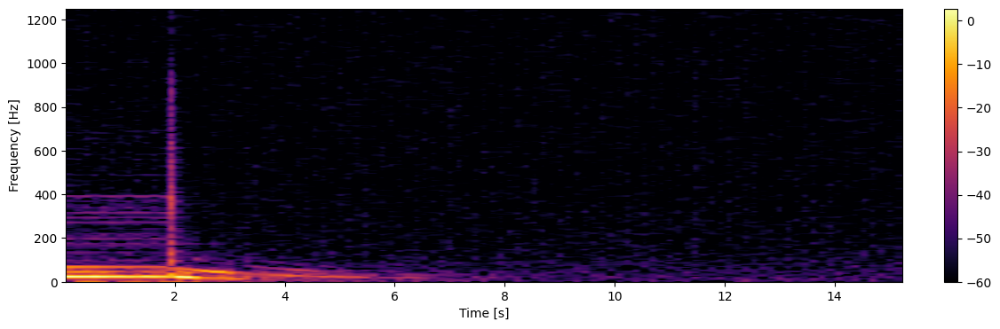

In [45]:
z_spectra = get_spectrograms(DATASET, 'z')

Spectrogram detail in Z axis

**1_still.tsv** (Z axis @ 5s)

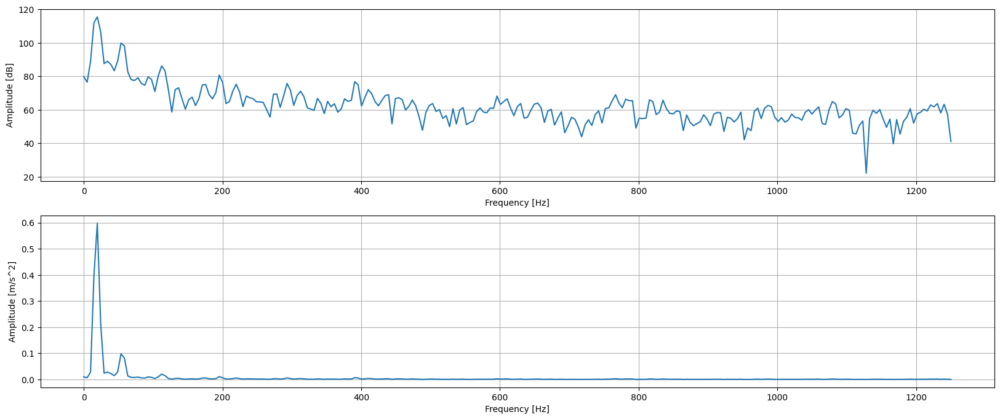

**2_still.tsv** (Z axis @ 5s)

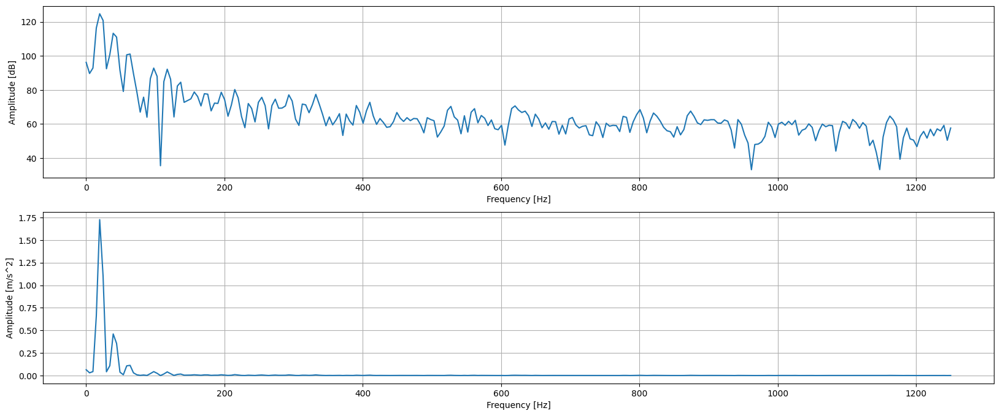

**3_still.tsv** (Z axis @ 5s)

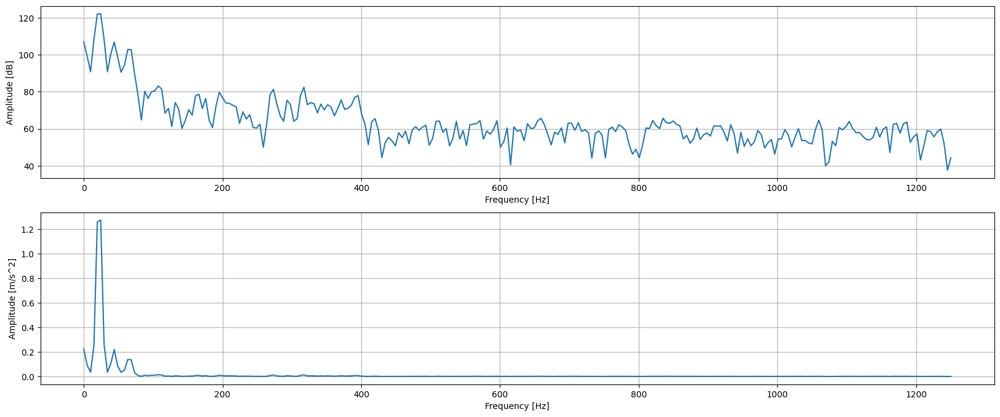

**1_up.tsv** (Z axis @ 5s)

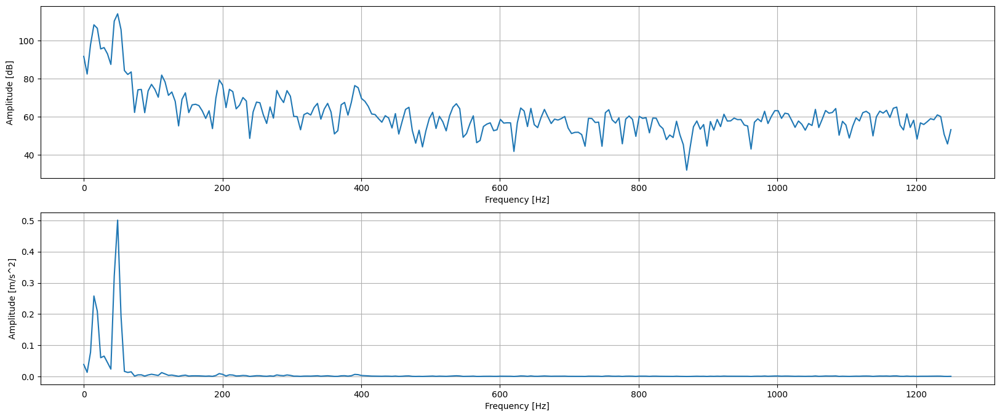

**2_up.tsv** (Z axis @ 5s)

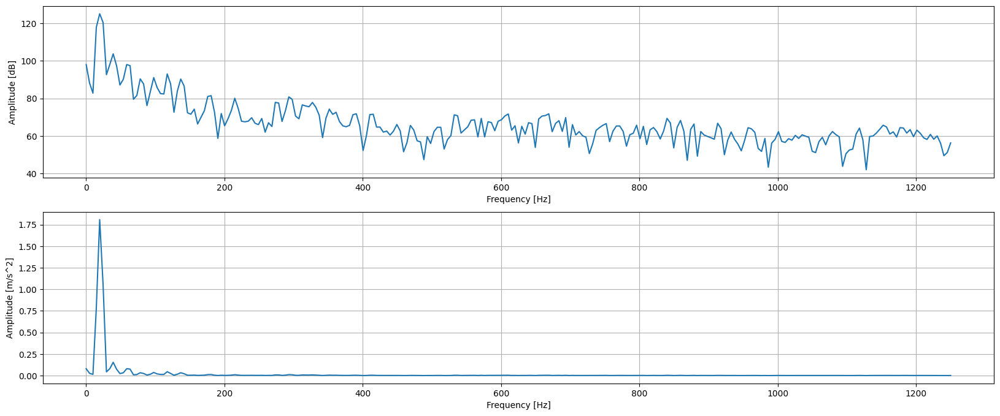

**3_up.tsv** (Z axis @ 5s)

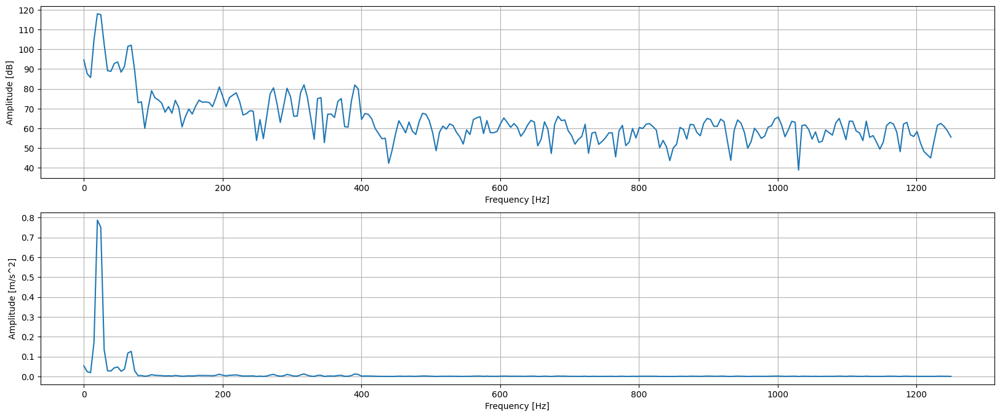

**1_down.tsv** (Z axis @ 5s)

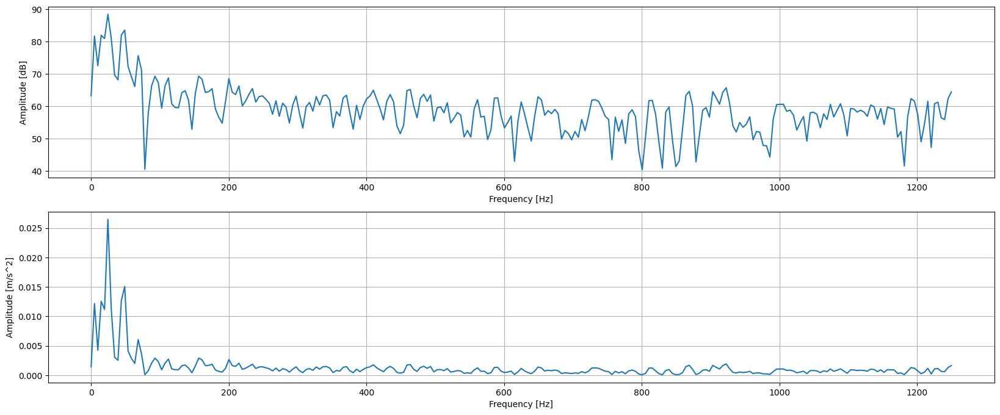

**2_down.tsv** (Z axis @ 5s)

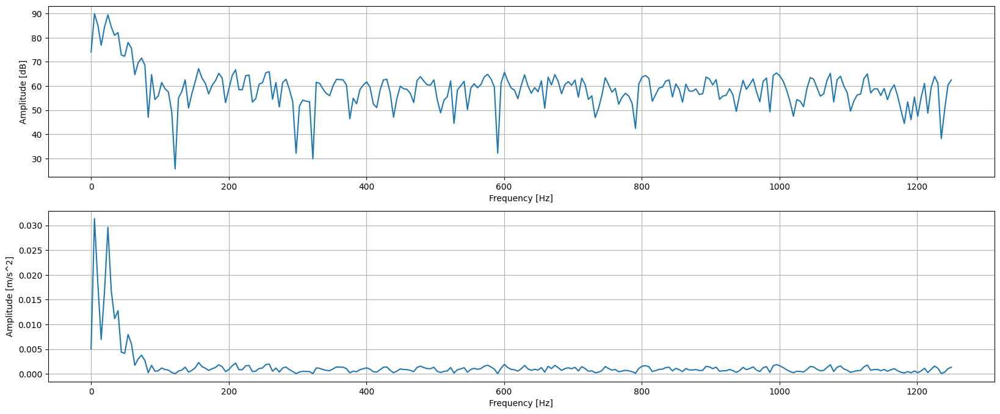

**3_down.tsv** (Z axis @ 5s)

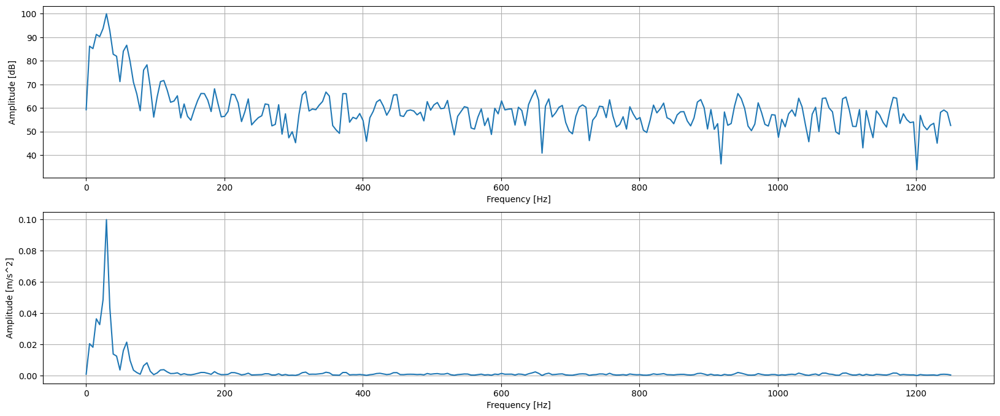

In [46]:
show_spectrogram_detail(z_spectra, 'z', T_SEC)

Peaks in frequency spectrum in Z axis

**1_still.tsv** (Z axis @ 5s)

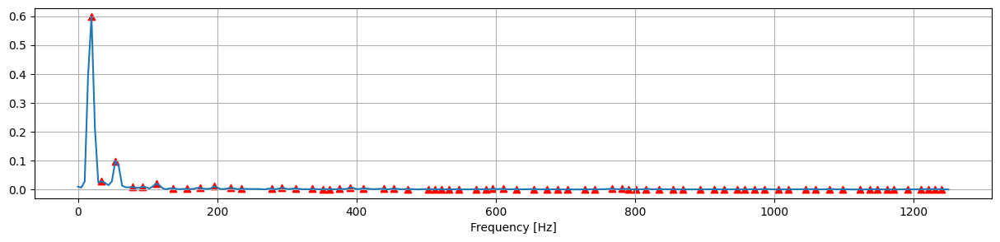

**2_still.tsv** (Z axis @ 5s)

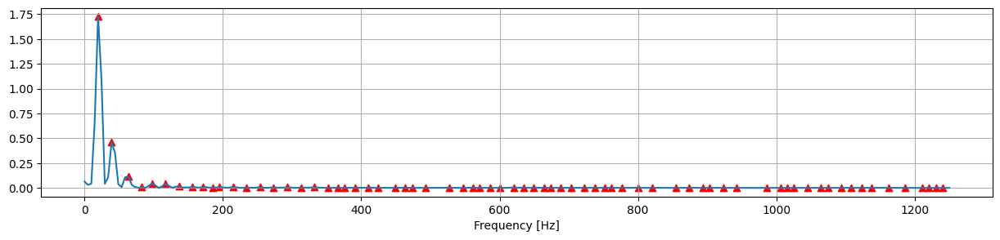

**3_still.tsv** (Z axis @ 5s)

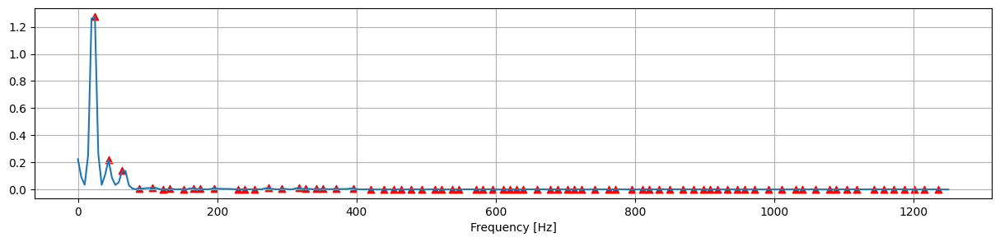

**1_up.tsv** (Z axis @ 5s)

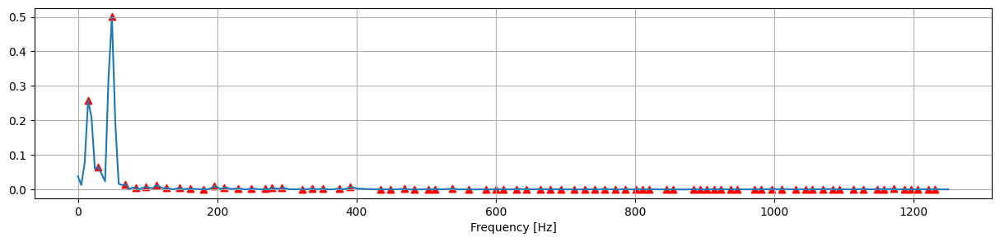

**2_up.tsv** (Z axis @ 5s)

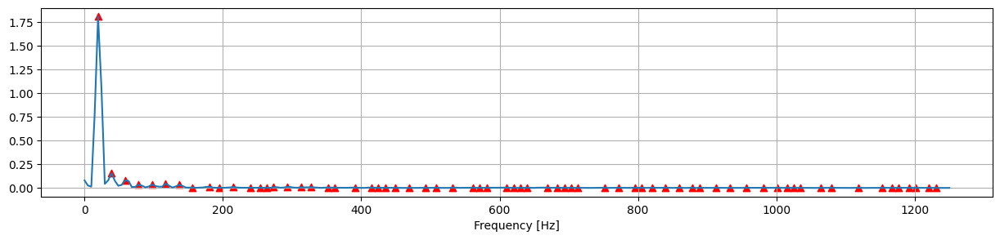

**3_up.tsv** (Z axis @ 5s)

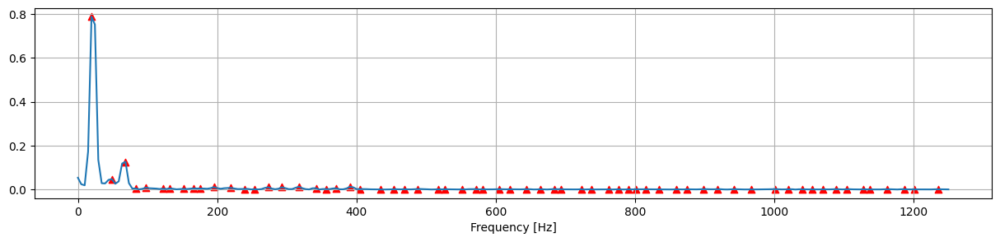

**1_down.tsv** (Z axis @ 5s)

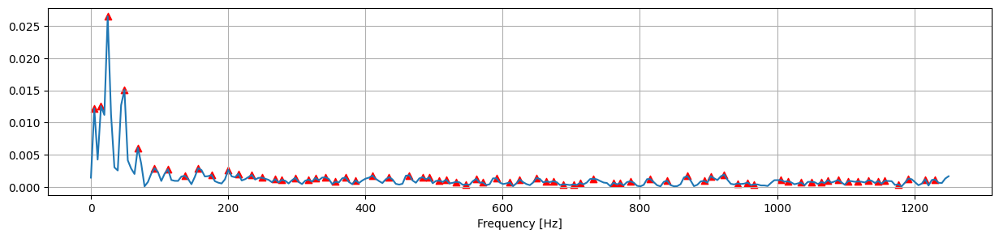

**2_down.tsv** (Z axis @ 5s)

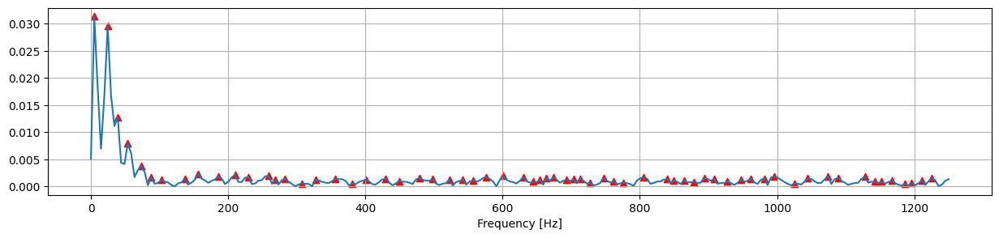

**3_down.tsv** (Z axis @ 5s)

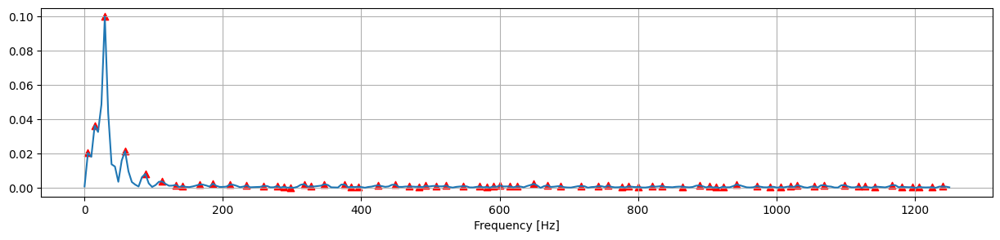

In [47]:
show_mms_peaks(z_spectra, 'z', T_SEC)

Harmonic series detection in Z axis

**1_still.tsv** (Z axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,0.598242
2,34.1797,0.0281259
3,53.7109,0.0981825
4,78.125,0.00904359
5,92.7734,0.00960221
6,112.305,0.0204995
7,361.328,0.00152038
8,512.695,0.00101309


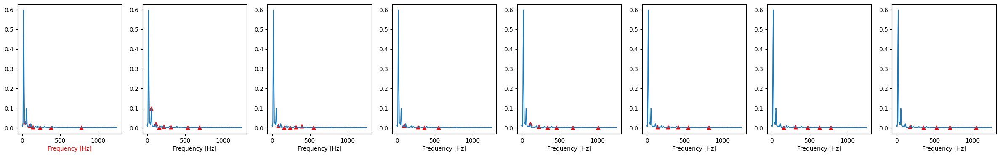

**2_still.tsv** (Z axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,1.72634
2,39.0625,0.460627
3,63.4766,0.113223
4,83.0078,0.00612227
5,97.6562,0.0437609
6,170.898,0.00773551
7,473.633,0.0014477
8,703.125,0.00155347


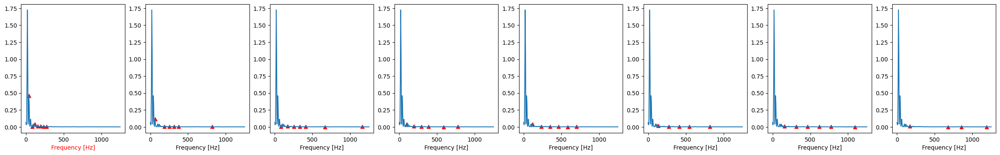

**3_still.tsv** (Z axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,24.4141,1.27488
2,43.9453,0.219873
3,63.4766,0.138212
4,87.8906,0.0102777
5,122.07,0.00355465
6,166.016,0.00853154
7,239.258,0.00240824
8,1103.52,0.00157859


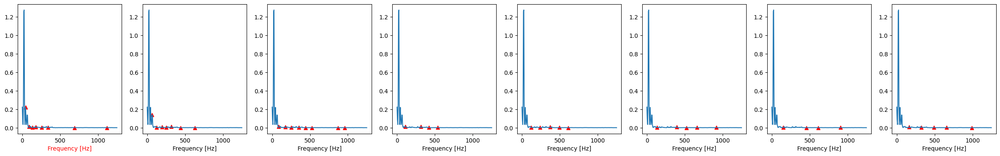

**1_up.tsv** (Z axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,14.6484,0.25772
2,29.2969,0.0652615
3,48.8281,0.500745
4,48.8281,0.500745
5,68.3594,0.0150294
6,83.0078,0.00522931
7,97.6562,0.00710395
8,209.961,0.00525951
9,629.883,0.00170622


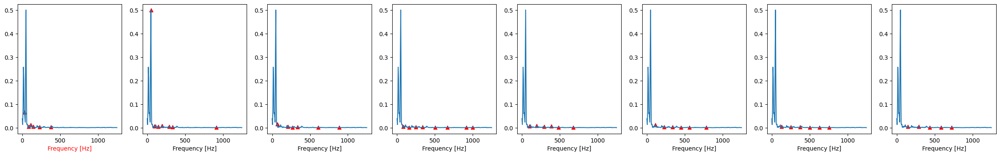

**2_up.tsv** (Z axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,1.80747
2,39.0625,0.153841
3,58.5938,0.0798493
4,78.125,0.0331016
5,97.6562,0.0358934
6,263.672,0.00223744
7,361.328,0.00425802
8,703.125,0.00199299


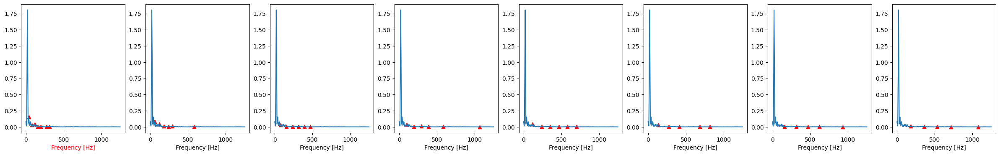

**3_up.tsv** (Z axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,19.5312,0.787065
2,48.8281,0.0476605
3,83.0078,0.00467982
4,97.6562,0.00895048
5,131.836,0.00510151
6,151.367,0.00308231
7,341.797,0.00598421
8,874.023,0.00126419


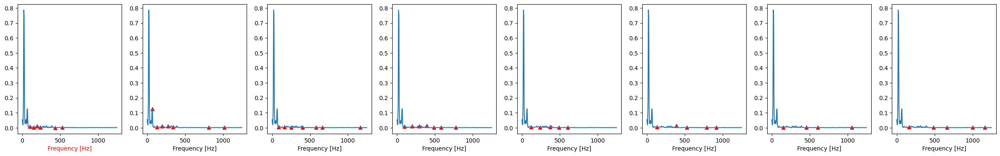

**1_down.tsv** (Z axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,4.88281,0.012185
2,4.88281,0.012185
3,14.6484,0.0125539
4,14.6484,0.0125539
5,24.4141,0.0264646
6,24.4141,0.0264646
7,48.8281,0.0150749
8,112.305,0.00275639
9,463.867,0.00182512


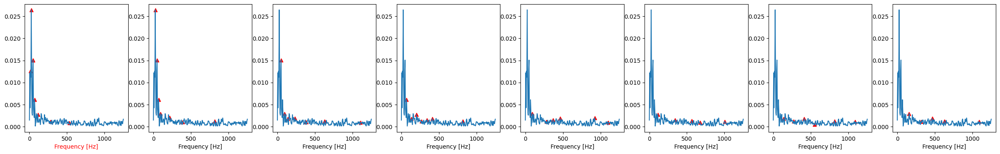

**2_down.tsv** (Z axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,4.88281,0.0313852
2,4.88281,0.0313852
3,4.88281,0.0313852
4,24.4141,0.029615
5,24.4141,0.029615
6,39.0625,0.0127637
7,87.8906,0.00171545
8,400.391,0.00121692


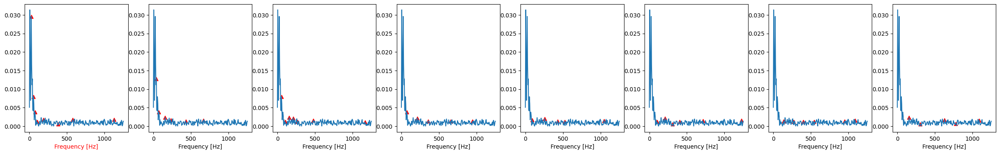

**3_down.tsv** (Z axis @ 5s)

,Frequency [Hz],Amplitude [m/s^2]
1,4.88281,0.0204595
2,4.88281,0.0204595
3,14.6484,0.0363999
4,14.6484,0.0363999
5,29.2969,0.0999142
6,29.2969,0.0999142
7,87.8906,0.00823027
8,131.836,0.00181124
9,375.977,0.0020119


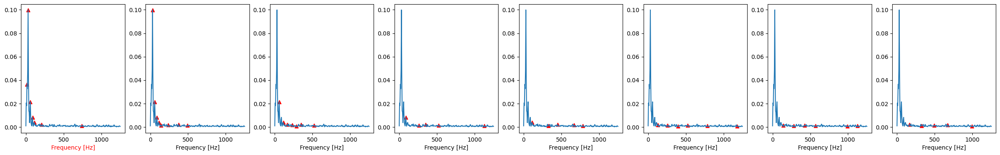

In [48]:
show_harmonic_series(z_spectra, 'z', T_SEC)

In [49]:
show_spectra_largest_amplitudes(z_spectra, 'z', T_SEC)

**1_still.tsv** (Z axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,0.598242,1
1,92.7734,0.00960221,4.75
2,175.781,0.00570918,9
3,439.453,0.00283587,22.5
4,454.102,0.0023033,23.25


**2_still.tsv** (Z axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,1.72634,1
1,136.719,0.0168433,7
2,332.031,0.00742667,17
3,410.156,0.00432779,21
4,527.344,0.00327741,27


**3_still.tsv** (Z axis @ 5s)

- *Fundamental frequency:* 24.4140625 Hz

,f,y,1x
0,24.4141,1.27488,1
1,273.438,0.011623,11.2
2,371.094,0.00599405,15.2
3,229.492,0.00286814,9.4
4,820.312,0.0016745,33.6


**1_up.tsv** (Z axis @ 5s)

- *Fundamental frequency:* 48.828125 Hz

,f,y,1x
0,48.8281,0.500745,1
1,195.312,0.00924016,4
2,278.32,0.00491589,5.7
3,249.023,0.00243771,5.1
4,161.133,0.00214016,3.3


**2_up.tsv** (Z axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,1.80747,1
1,78.125,0.0331016,4
2,273.438,0.00783417,14
3,195.312,0.00395028,10
4,532.227,0.00364328,27.25


**3_up.tsv** (Z axis @ 5s)

- *Fundamental frequency:* 19.53125 Hz

,f,y,1x
0,19.5312,0.787065,1
1,195.312,0.0111635,10
2,341.797,0.00598421,17.5
3,151.367,0.00308231,7.75
4,683.594,0.00202092,35


**1_down.tsv** (Z axis @ 5s)

- *Fundamental frequency:* 24.4140625 Hz

,f,y,1x
0,24.4141,0.0264646,1
1,92.7734,0.0029218,3.8
2,234.375,0.00188239,9.6
3,869.141,0.00170404,35.6
4,371.094,0.00148867,15.2


**2_down.tsv** (Z axis @ 5s)

- *Fundamental frequency:* 4.8828125 Hz

,f,y,1x
0,4.88281,0.0313852,1
1,156.25,0.00228919,32
2,185.547,0.00183081,38
3,87.8906,0.00171545,18
4,1225.59,0.0015785,251


**3_down.tsv** (Z axis @ 5s)

- *Fundamental frequency:* 29.296875 Hz

,f,y,1x
0,29.2969,0.0999142,1
1,185.547,0.00255029,6.33333
2,942.383,0.00202025,32.1667
3,1098.63,0.00170369,37.5
4,234.375,0.00155523,8


Histogram

**1_still.tsv**

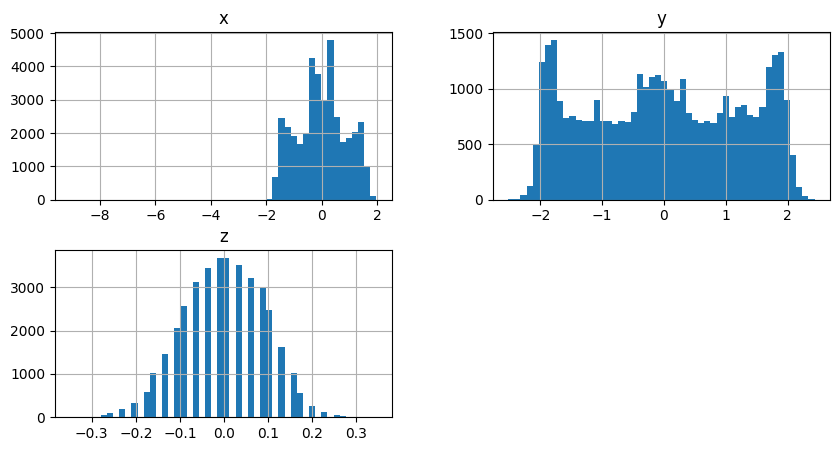

**2_still.tsv**

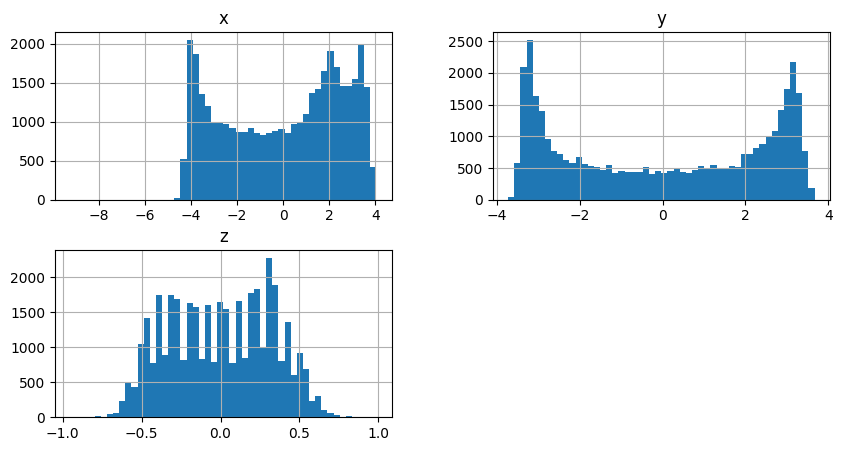

**3_still.tsv**

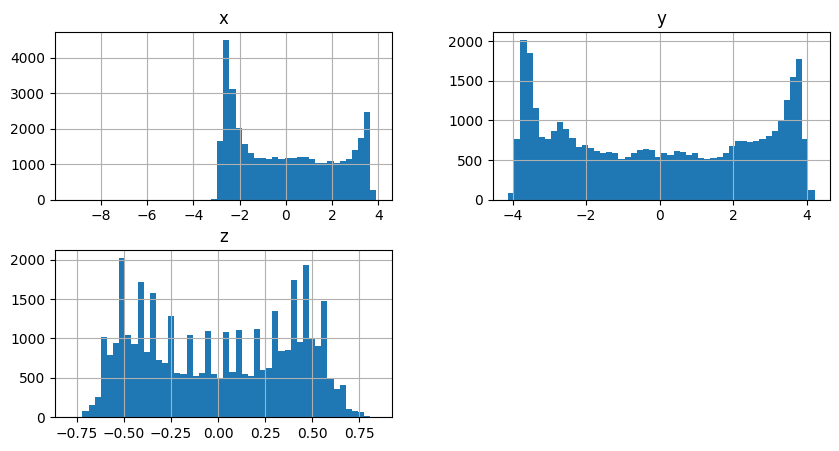

**1_up.tsv**

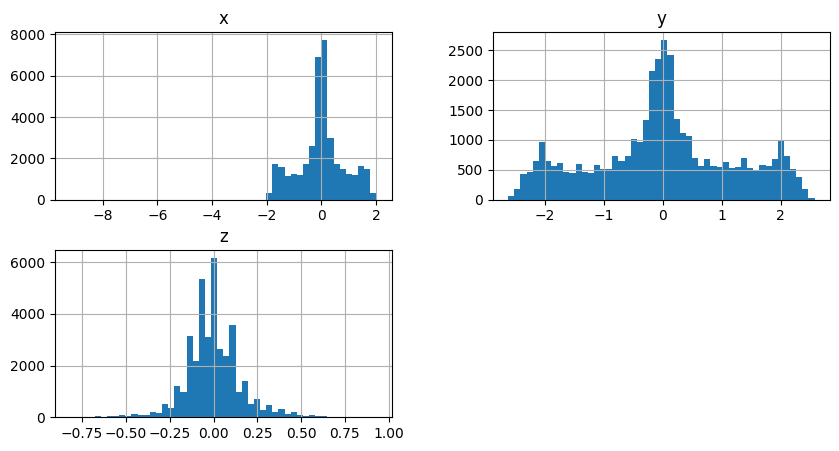

**2_up.tsv**

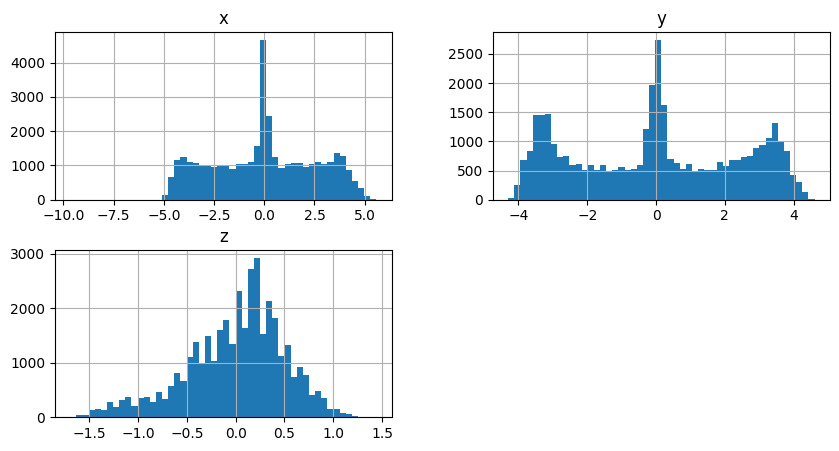

**3_up.tsv**

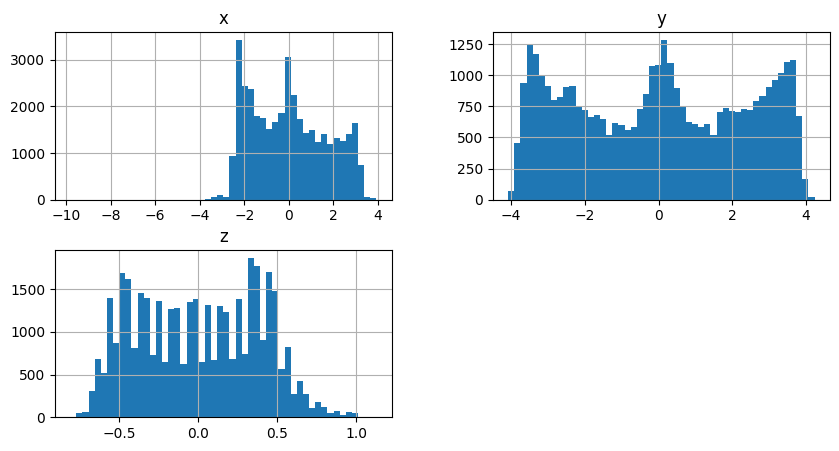

**1_down.tsv**

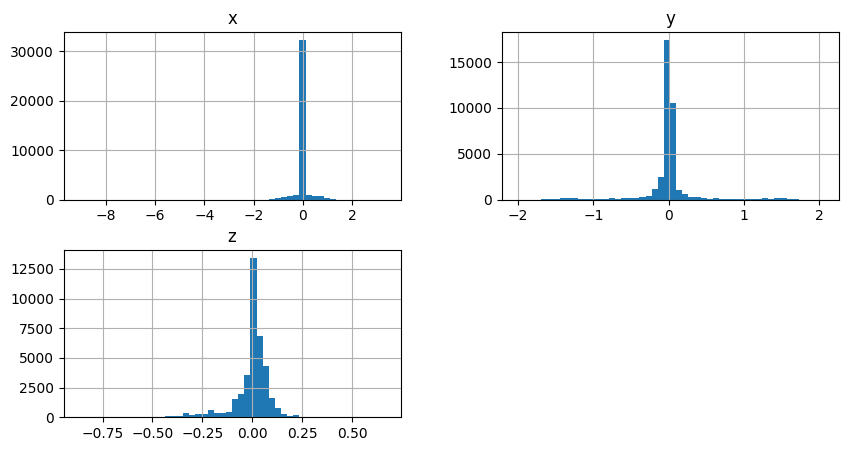

**2_down.tsv**

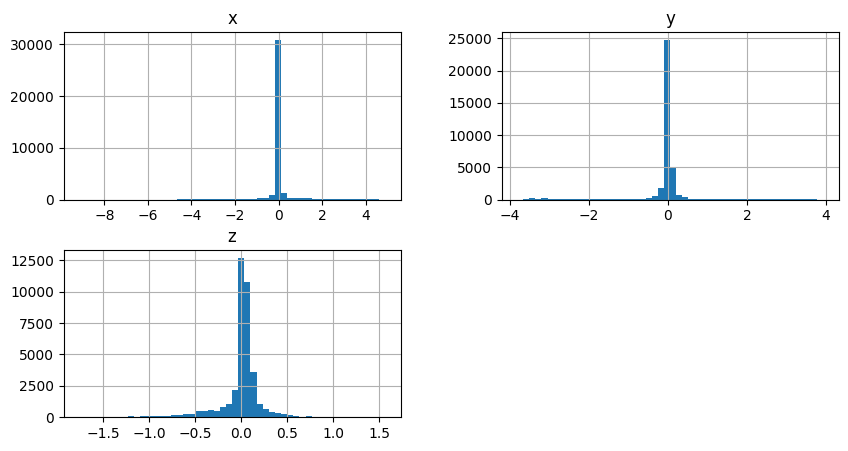

**3_down.tsv**

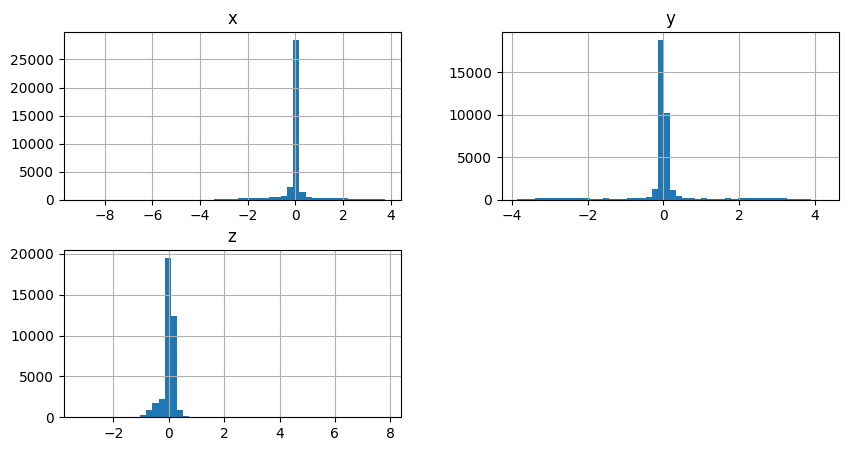

In [50]:
axis = ['x', 'y', 'z']
for name, ts in DATASET:
    display(Markdown(f'**{name}**'))
    ts[axis].hist(figsize=(10, 5), grid=True, bins=50)
    plt.show()

Orbitals of all cross sections

**1_still.tsv**

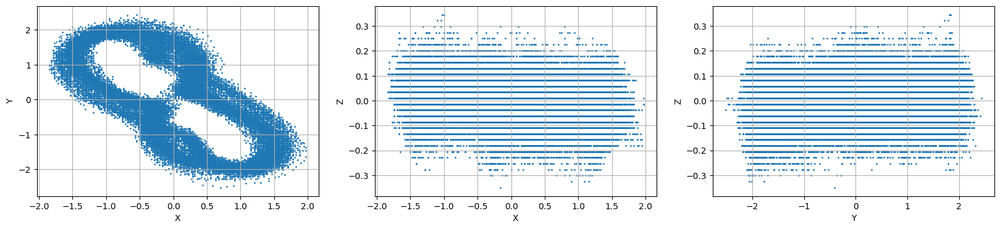

**2_still.tsv**

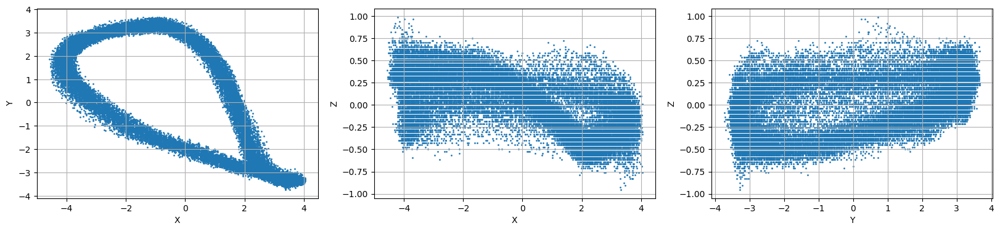

**3_still.tsv**

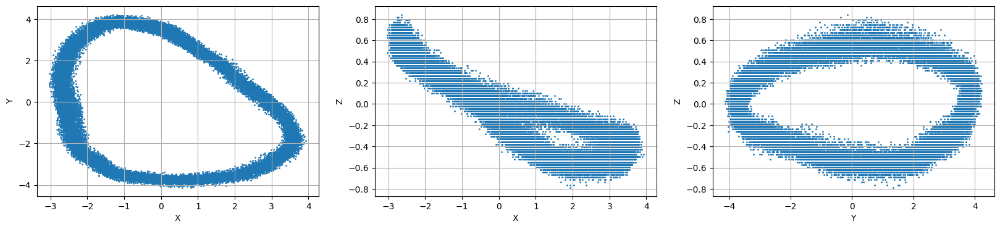

**1_up.tsv**

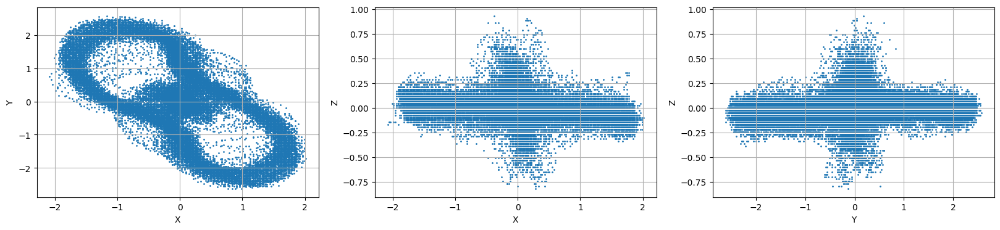

**2_up.tsv**

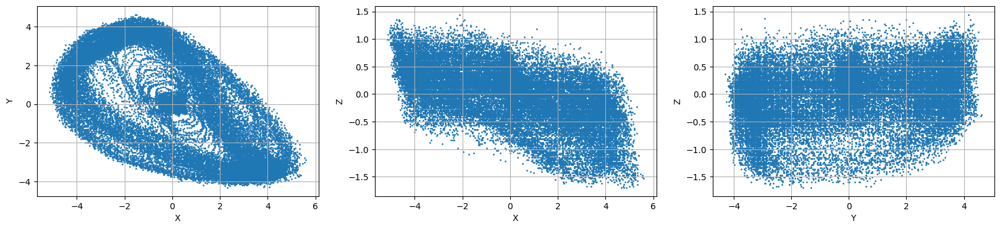

**3_up.tsv**

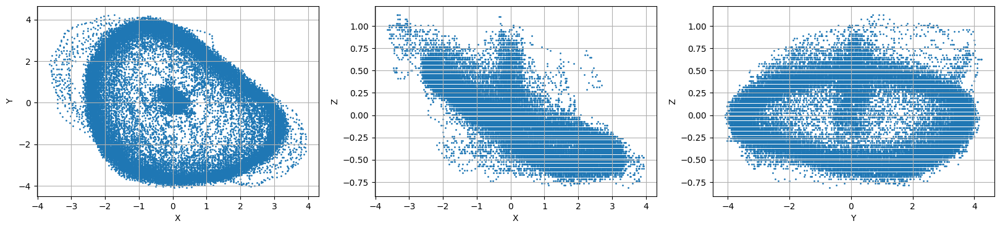

**1_down.tsv**

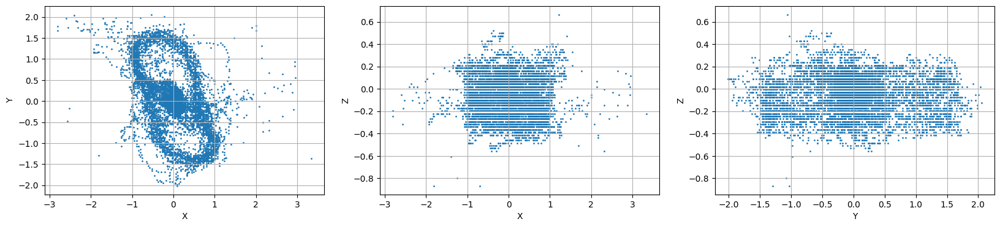

**2_down.tsv**

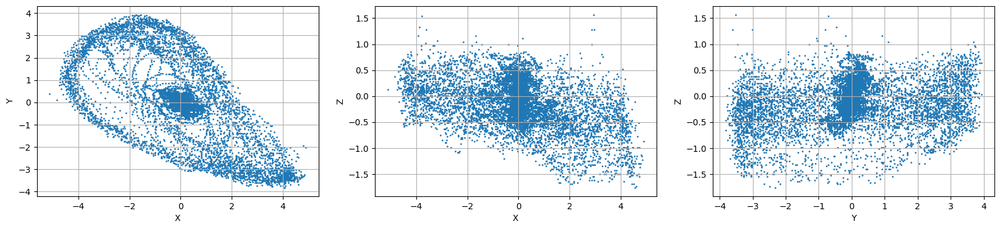

**3_down.tsv**

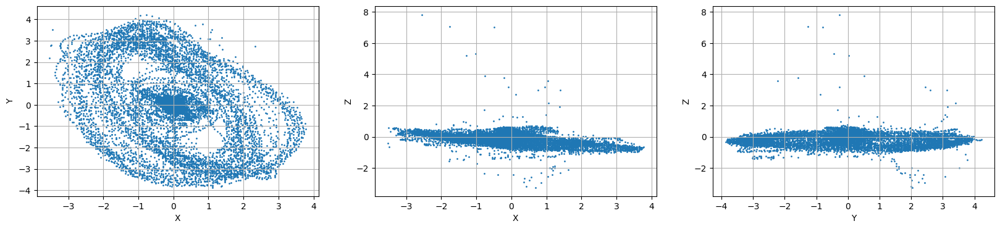

In [51]:
for name, ts in DATASET:
    display(Markdown(f'**{name}**'))
    fig, ax = plt.subplots(1, 3, figsize=(20, 4))

    for i, col in enumerate([('x', 'y'), ('x', 'z'), ('y', 'z')]):
        ax[i].scatter(ts[col[0]], ts[col[1]], s=1)
        ax[i].grid(True)
        ax[i].set_xlabel(col[0].upper())
        ax[i].set_ylabel(col[1].upper())
        ax[i].grid(True)
    plt.show()       # plt.savefig('orbitals.png')

Orbitals of 1x harmonic frequency

**1_still.tsv**

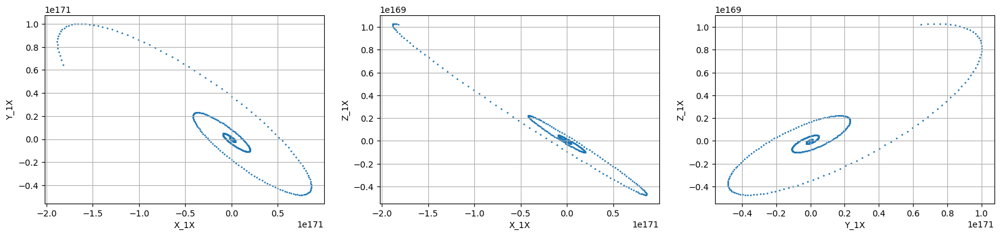

**2_still.tsv**

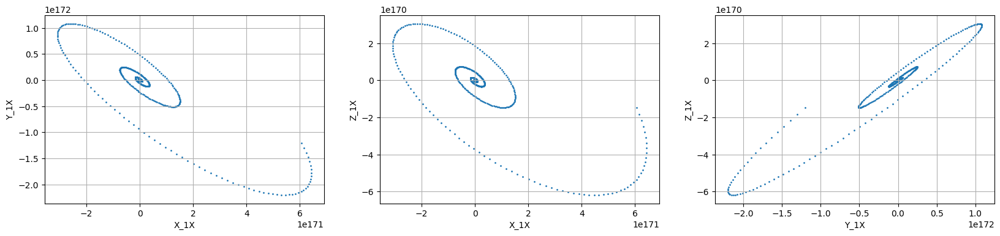

**3_still.tsv**

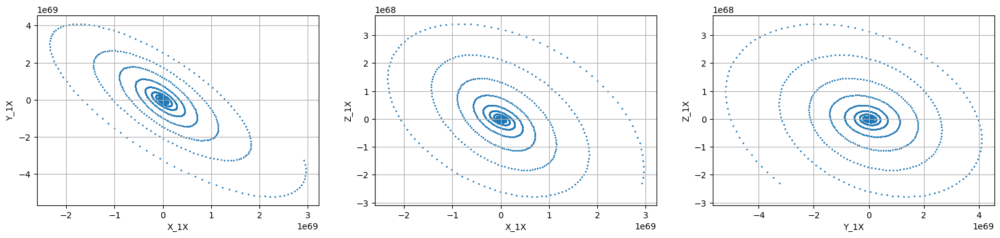

**1_up.tsv**

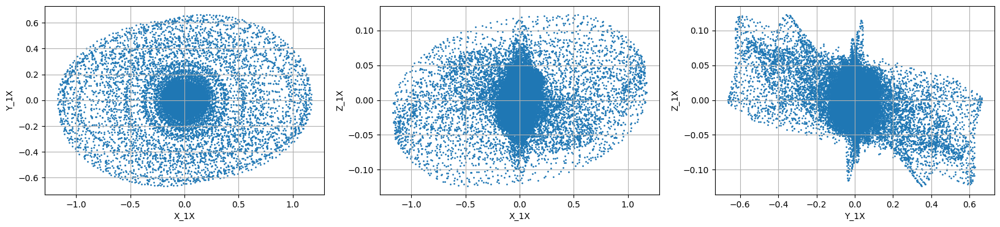

**2_up.tsv**

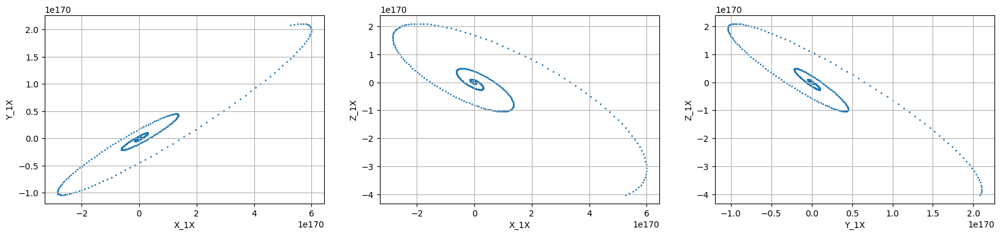

**3_up.tsv**

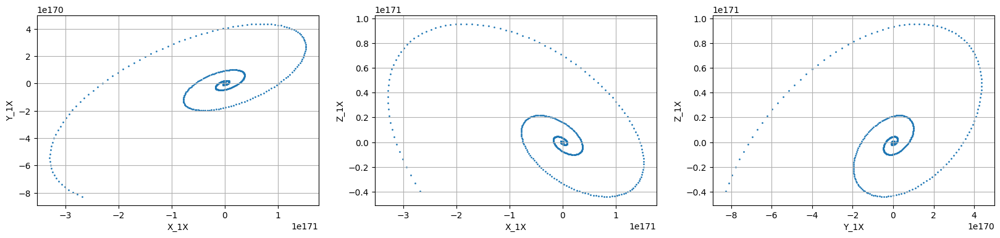

**1_down.tsv**

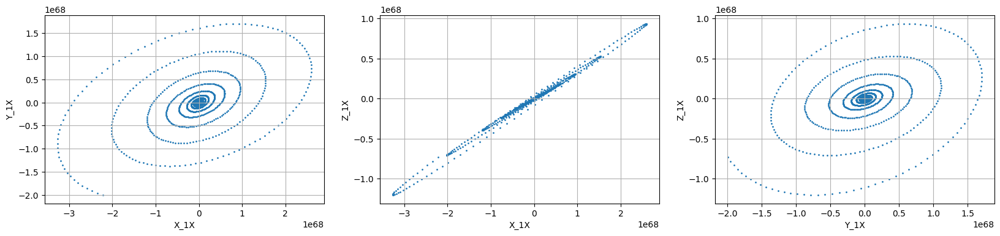

**2_down.tsv**

ValueError: filter critical frequencies must be greater than 0

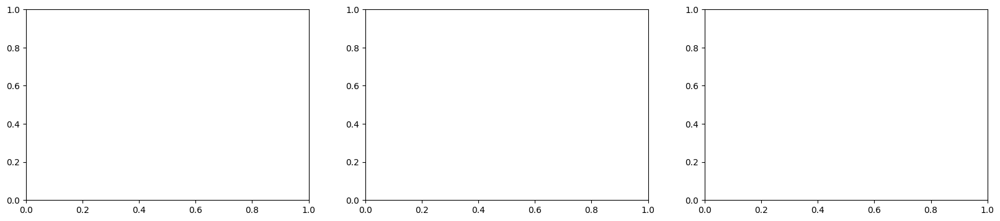

In [52]:
x_spectra_by_name = {spec[0]: spec for spec in x_spectra}
y_spectra_by_name = {spec[0]: spec for spec in y_spectra}
z_spectra_by_name = {spec[0]: spec for spec in z_spectra}
t = 5
space = 5

for name, ts in DATASET:
    display(Markdown(f'**{name}**'))
    fig, ax = plt.subplots(1, 3, figsize=(20, 4))

    name, freqs, Pxx = x_spectra_by_name[name]
    x_fundamental = get_max_frequency(freqs, Pxx, window_idx(t))

    name, freqs, Pxx = y_spectra_by_name[name]
    y_fundamental = get_max_frequency(freqs, Pxx, window_idx(t))

    name, freqs, Pxx = z_spectra_by_name[name]
    z_fundamental = get_max_frequency(freqs, Pxx, window_idx(t))

    ts['x_1x'] = butter_bandpass_filter(ts['x'], x_fundamental - space, x_fundamental + space, Fs)
    ts['y_1x'] = butter_bandpass_filter(ts['y'], y_fundamental - space, y_fundamental + space, Fs)
    ts['z_1x'] = butter_bandpass_filter(ts['z'], z_fundamental - space, z_fundamental + space, Fs)
    
    for i, col in enumerate([('x_1x', 'y_1x'), ('x_1x', 'z_1x'), ('y_1x', 'z_1x')]):
        ax[i].scatter(ts[col[0]], ts[col[1]], s=1)
        ax[i].grid(True)
        ax[i].set_xlabel(col[0].upper())
        ax[i].set_ylabel(col[1].upper())
        ax[i].grid(True)
    
    plt.show()       # plt.savefig('orbitals_1x.png')